# Implementation of Wasserstein GAN with Gradient Penalty

## Import libraries

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

## Model Section

### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

### Critic

In [4]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

### Training Initializations

In [6]:
n_epochs = 10 #100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda' if torch.cuda.is_available() else 'cpu'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

100%|██████████| 9912422/9912422 [00:00<00:00, 247077383.04it/s]

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw


100%|██████████| 28881/28881 [00:00<00:00, 112475110.33it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 76533701.44it/s]


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 20729628.69it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



In [7]:
## initialize generator, critic, and optimizers
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)

### Gradient Penalty

In [8]:
## get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient

In [9]:
## gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    penalty = torch.mean((gradient_norm - 1)**2)
    return penalty

### Losses

In [10]:
## get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    gen_loss = -1. * torch.mean(crit_fake_pred)

    return gen_loss

In [11]:
## get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp

    return crit_loss

### Model Training

In [12]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50: Generator loss: -0.05281799001968466, critic loss: 2.156329150438309


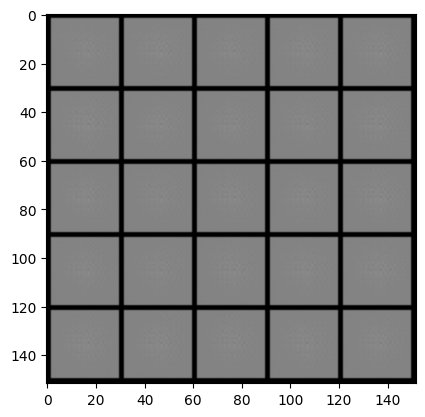

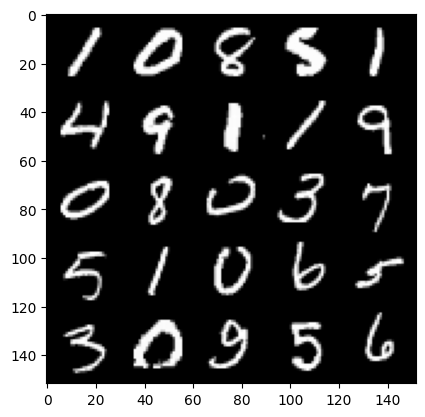

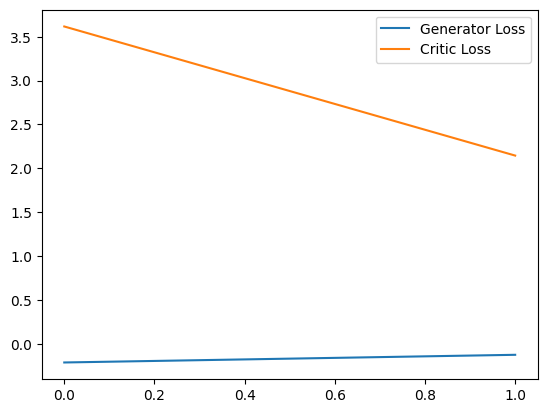

Step 100: Generator loss: 1.420703564286232, critic loss: -3.3430486139655113


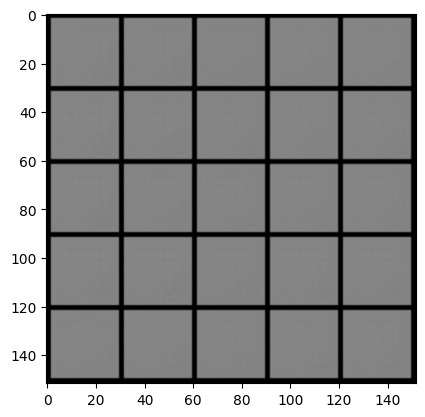

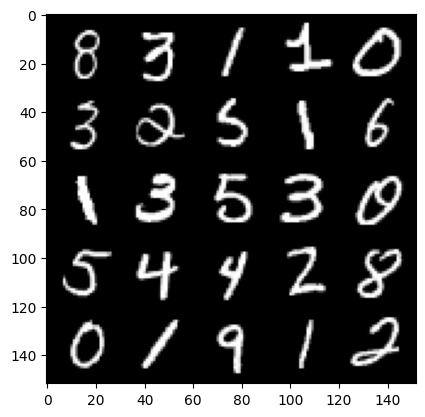

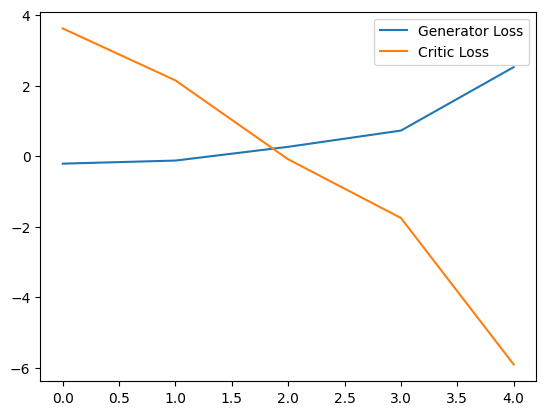

Step 150: Generator loss: 1.5434513484127819, critic loss: -15.790771831512448


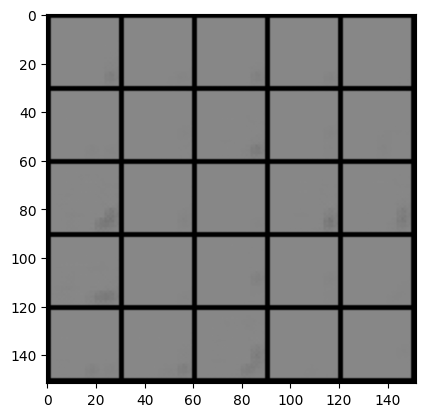

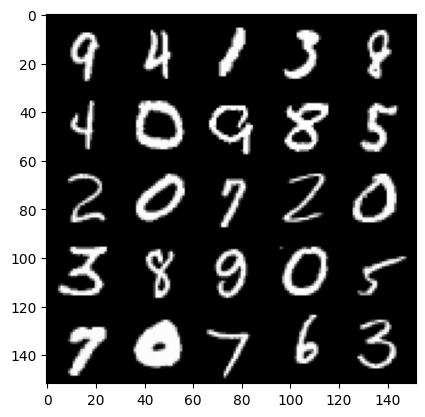

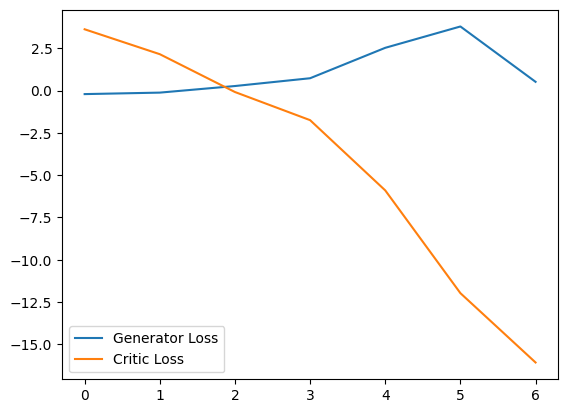

Step 200: Generator loss: -1.6066379456222057, critic loss: -37.23574378204345


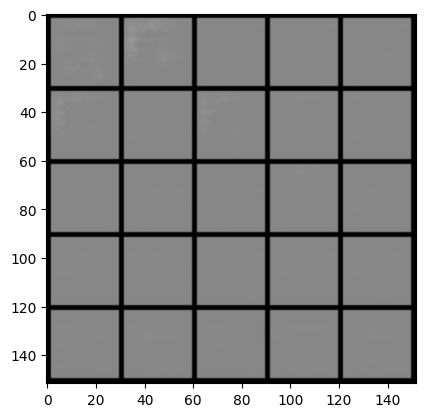

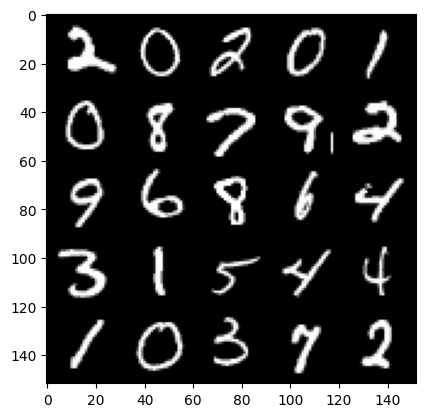

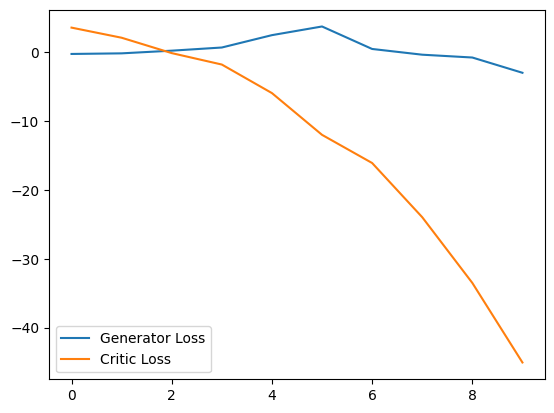

Step 250: Generator loss: -3.516218161582947, critic loss: -71.06341593933104


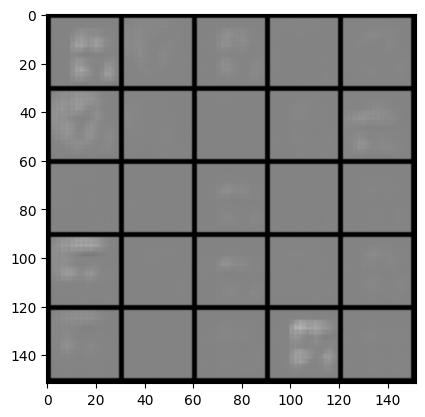

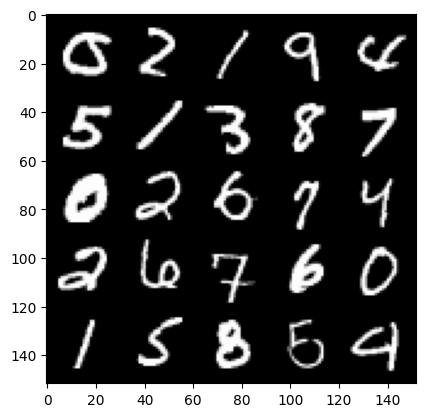

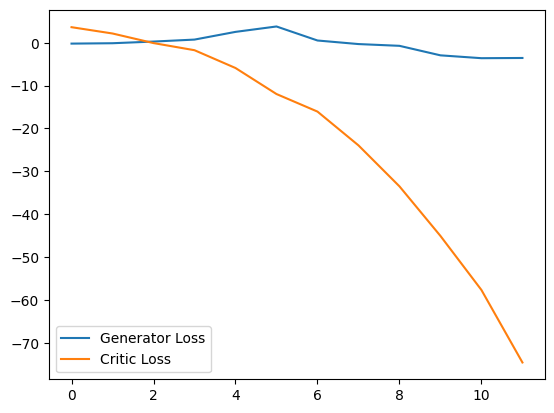

Step 300: Generator loss: -3.094732226729393, critic loss: -119.85153369140626


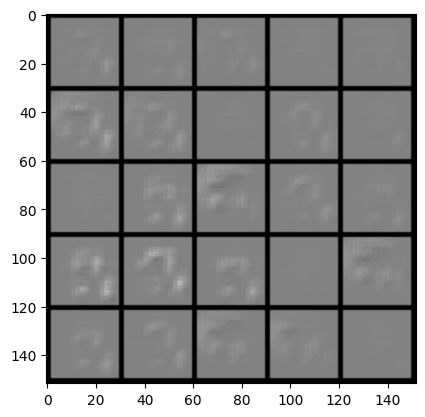

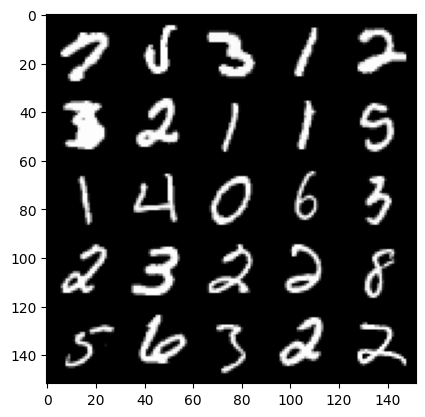

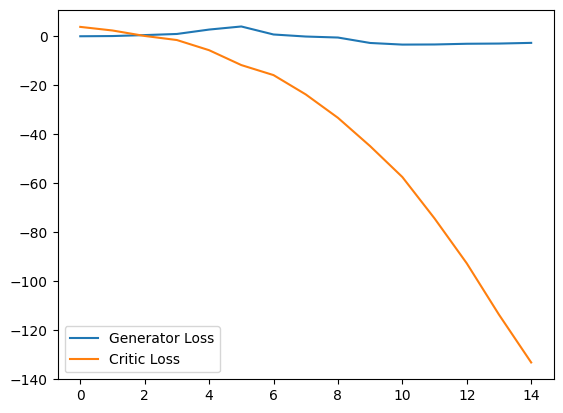

Step 350: Generator loss: -1.9726458942890168, critic loss: -177.49187322998048


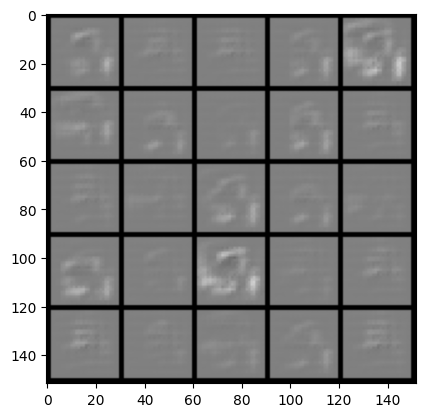

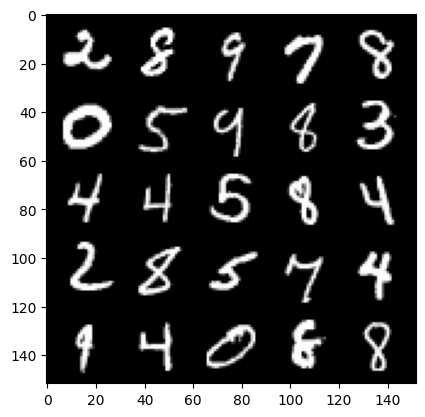

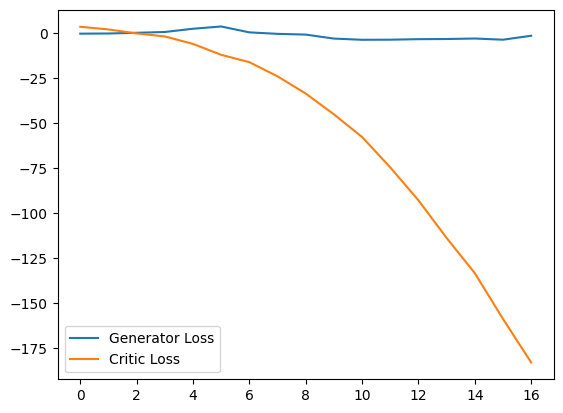

Step 400: Generator loss: 0.5172115330398083, critic loss: -239.63438946533205


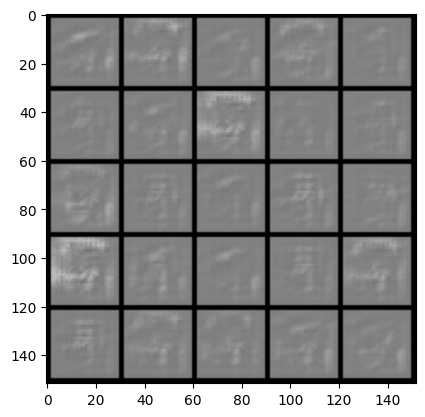

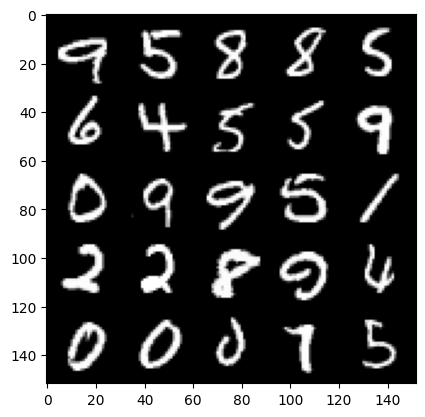

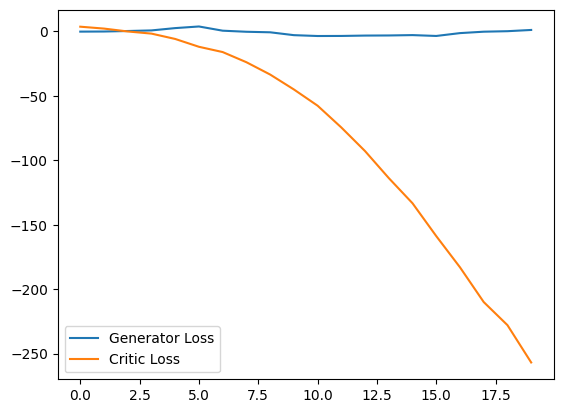

Step 450: Generator loss: -0.1439407455921173, critic loss: -293.79637188720704


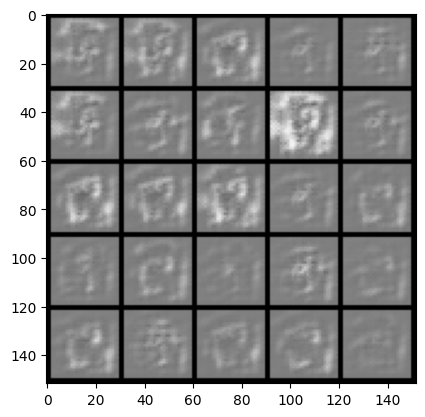

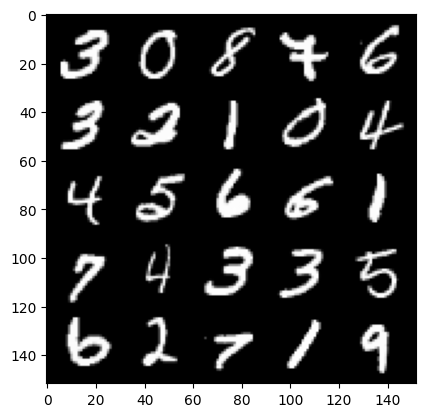

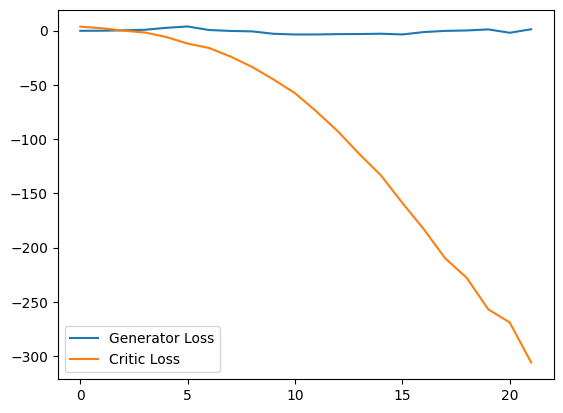

  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 2.1055966234207153, critic loss: -356.02461309814447


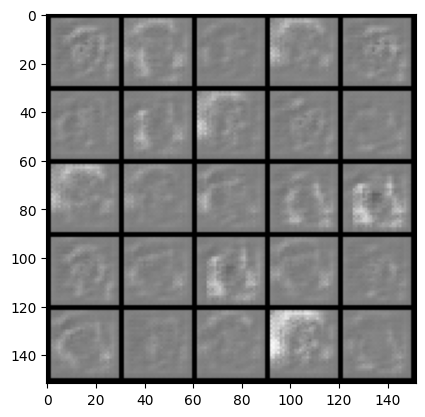

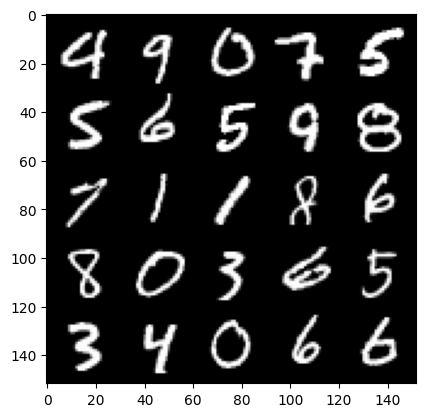

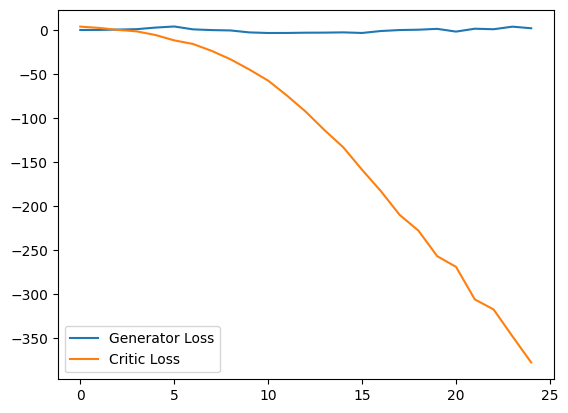

Step 550: Generator loss: -4.494797703027725, critic loss: -404.48169824218763


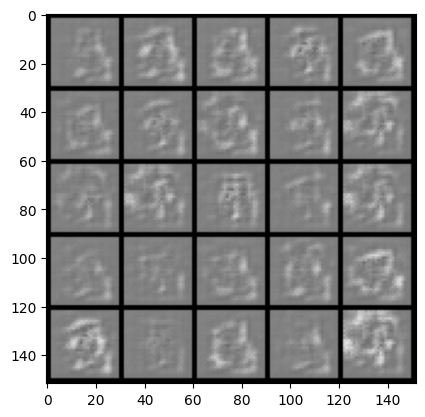

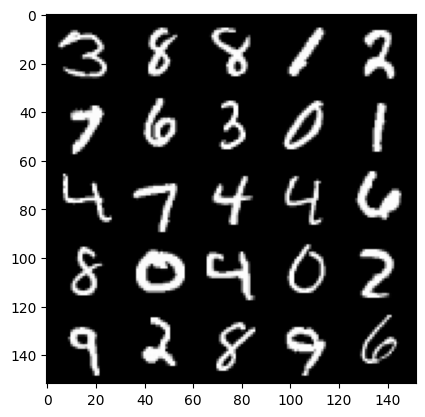

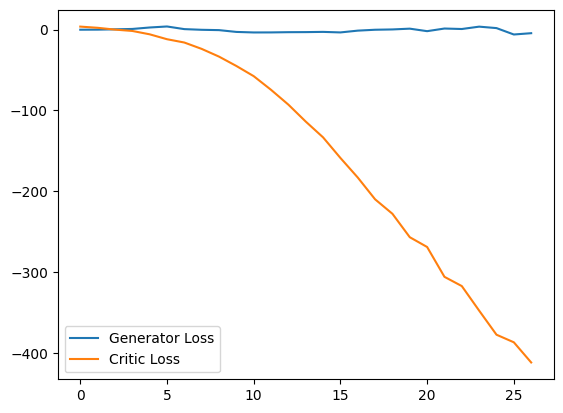

Step 600: Generator loss: -36.405402607917786, critic loss: -361.2887665710449


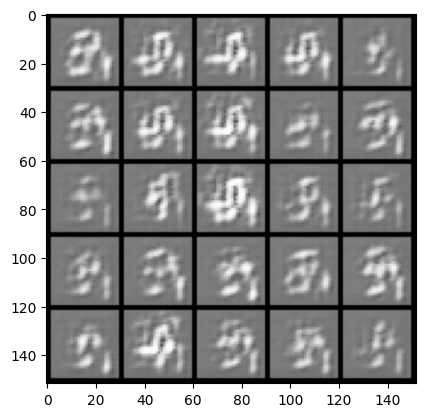

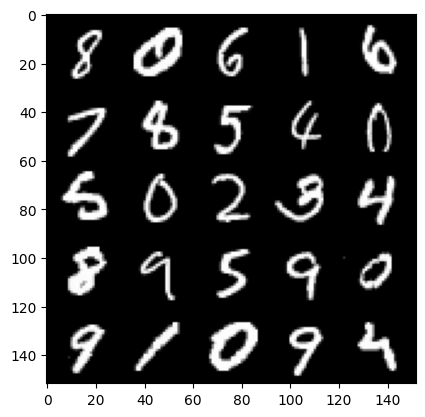

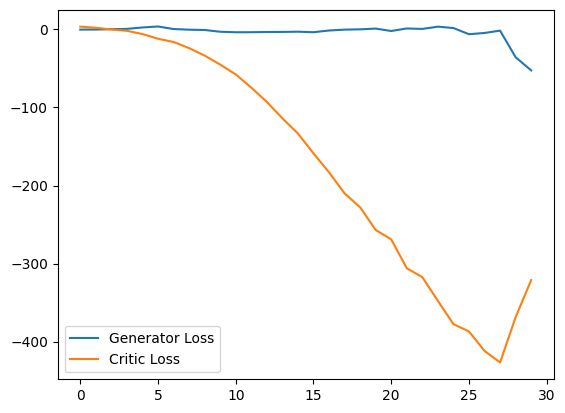

Step 650: Generator loss: 14.797283589839935, critic loss: -475.33776397705077


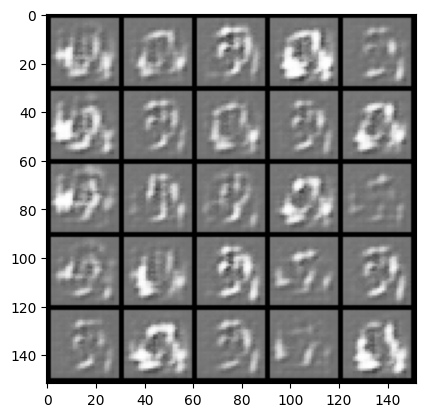

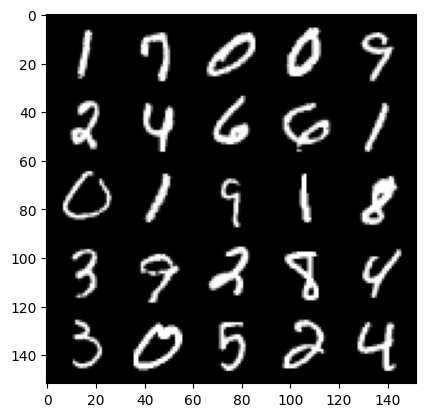

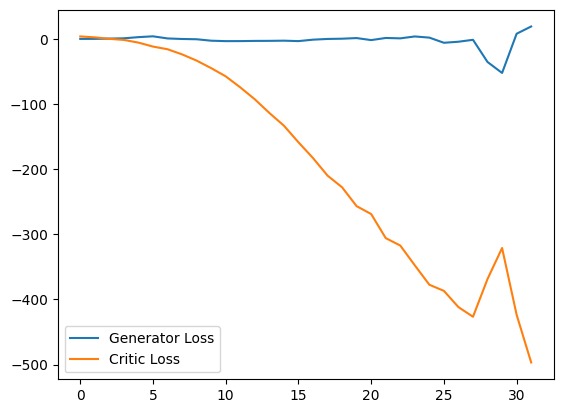

Step 700: Generator loss: 14.219850096702576, critic loss: -568.6662176513671


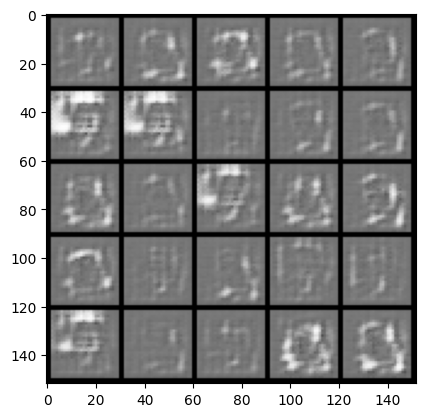

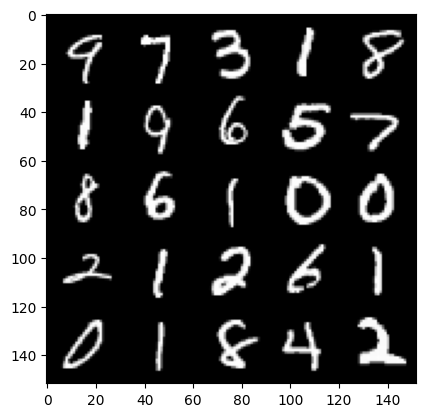

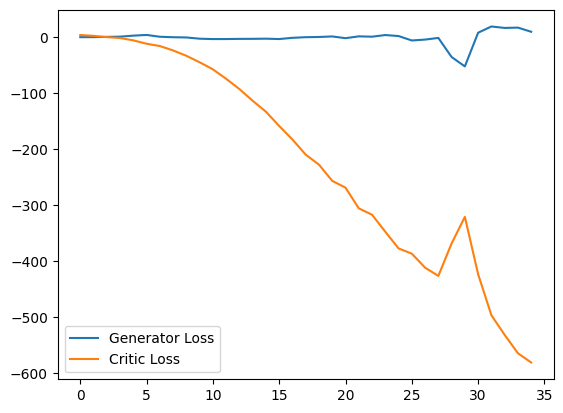

Step 750: Generator loss: 2.808791556060314, critic loss: -623.8586964111327


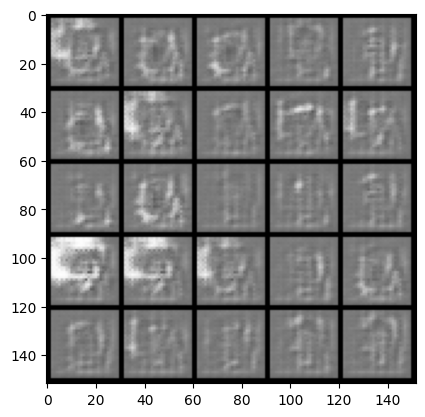

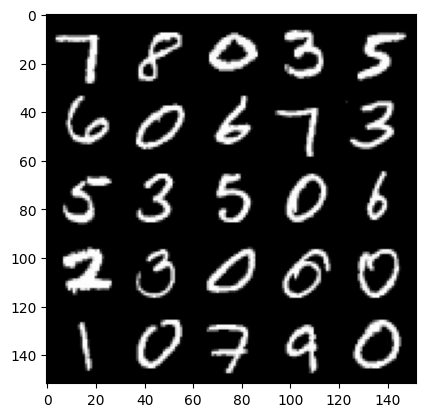

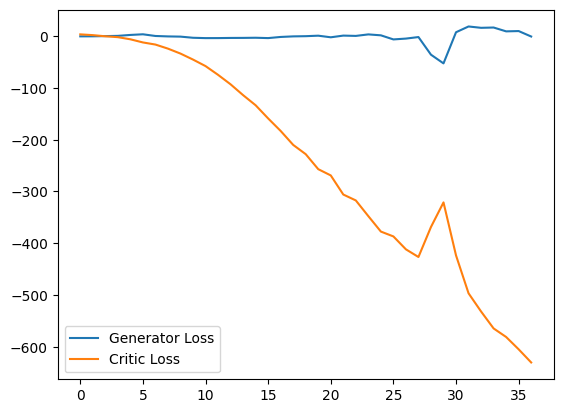

Step 800: Generator loss: -25.443165063261986, critic loss: -579.2974979248047


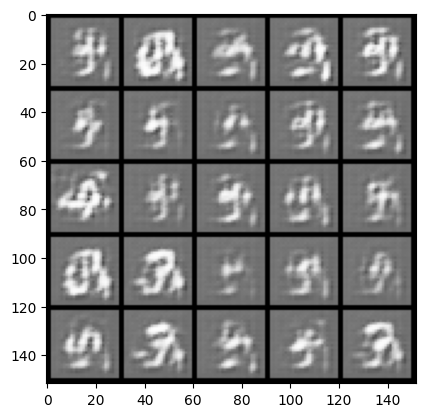

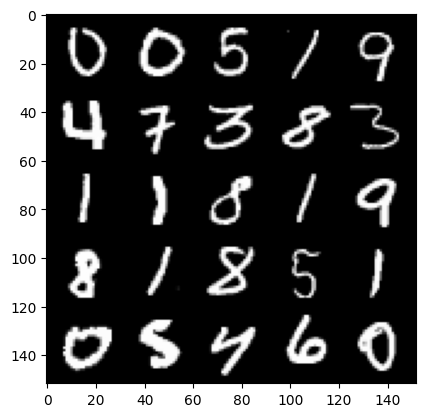

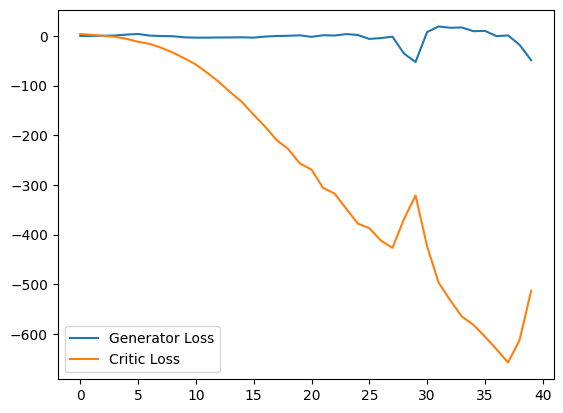

Step 850: Generator loss: 10.275469932556152, critic loss: -645.943812072754


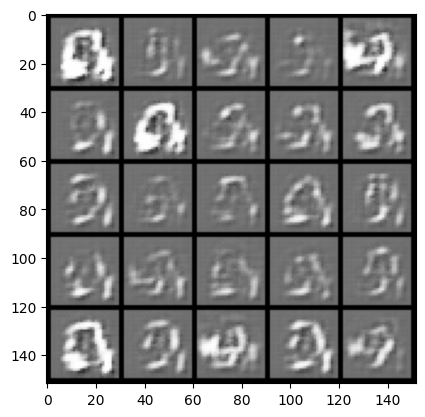

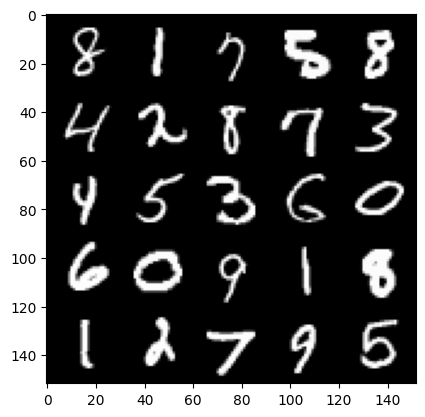

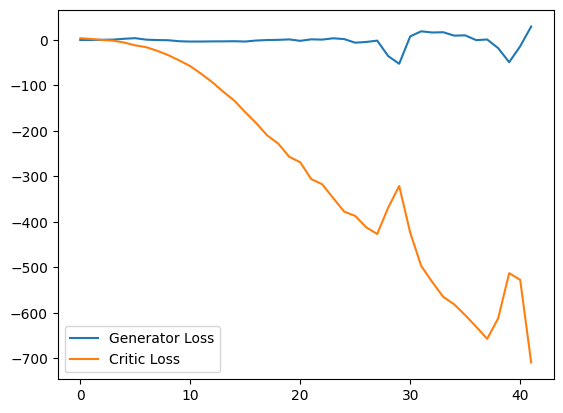

Step 900: Generator loss: 12.107688846588134, critic loss: -675.1996219482422


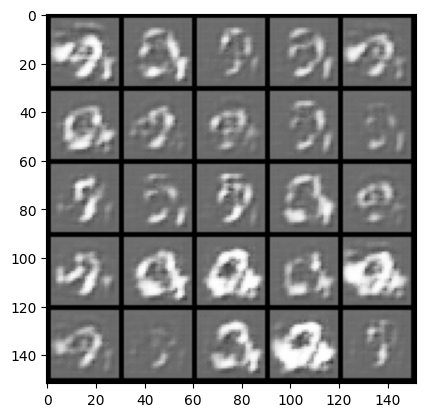

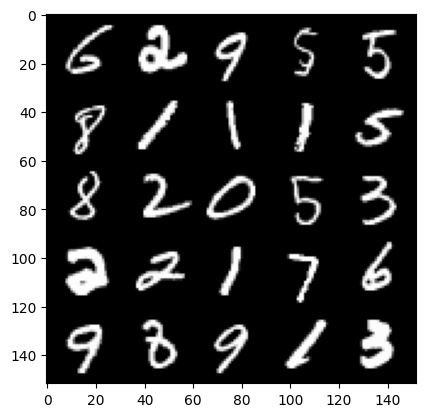

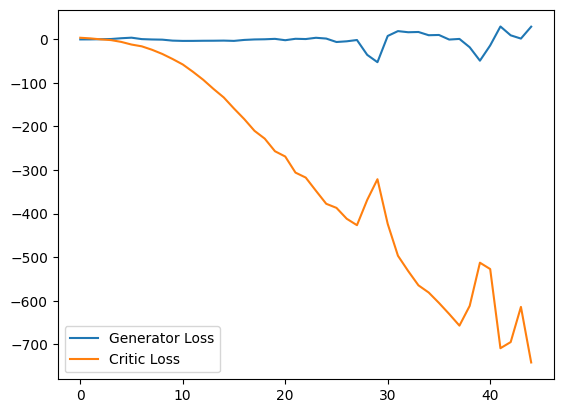

  0%|          | 0/469 [00:00<?, ?it/s]

Step 950: Generator loss: -10.052695678472519, critic loss: -657.573210571289


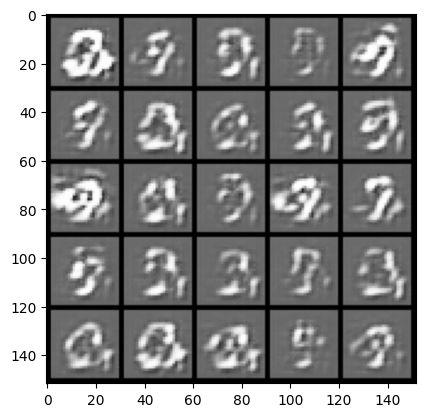

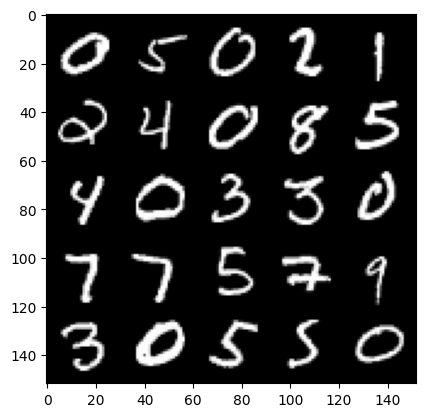

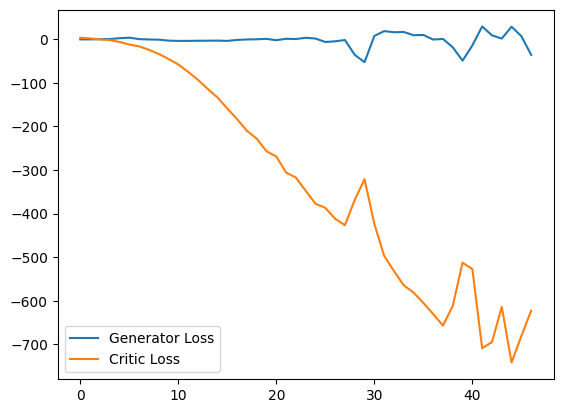

Step 1000: Generator loss: -11.221703660488128, critic loss: -660.1950766601564


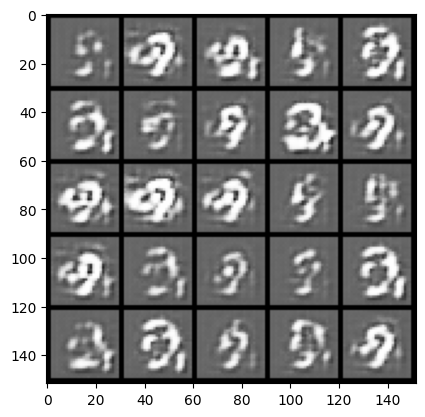

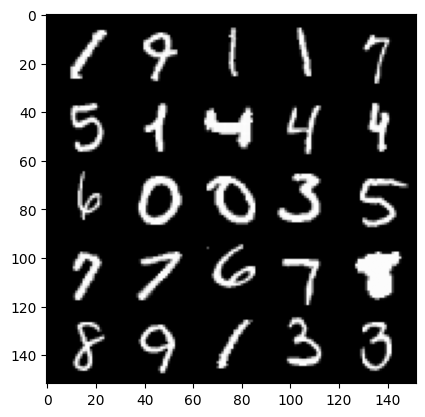

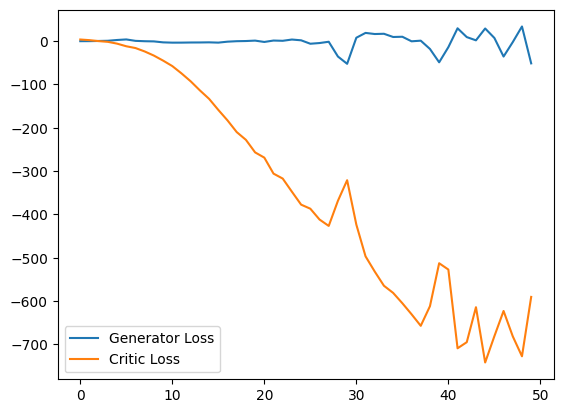

Step 1050: Generator loss: -129.5010234642029, critic loss: -435.4289147949219


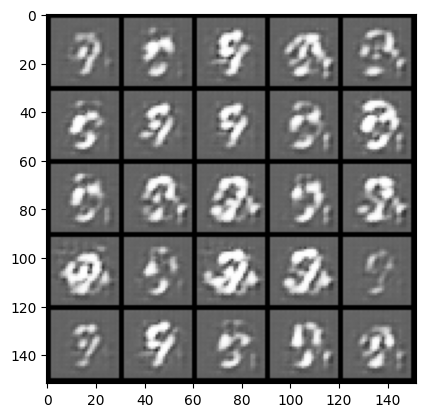

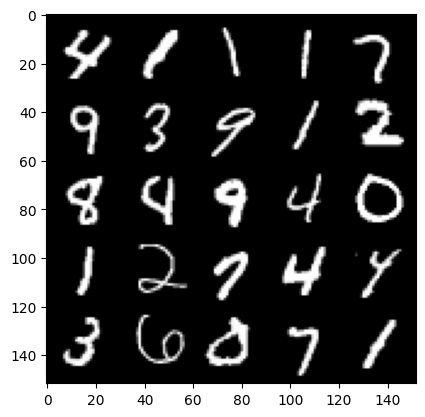

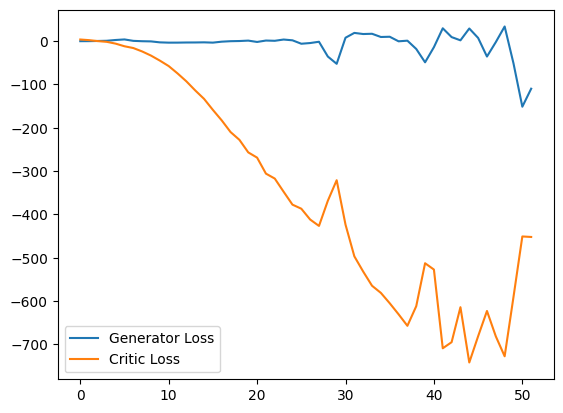

Step 1100: Generator loss: -37.98233912467956, critic loss: -548.7726388549804


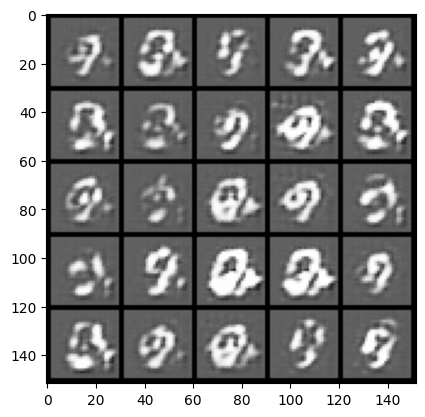

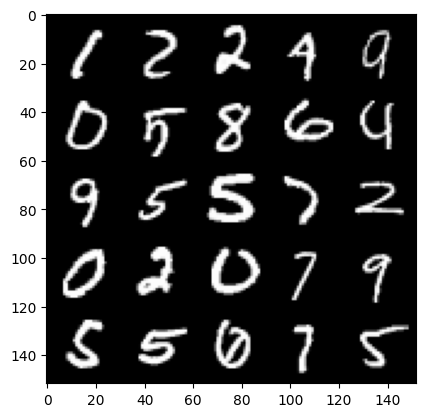

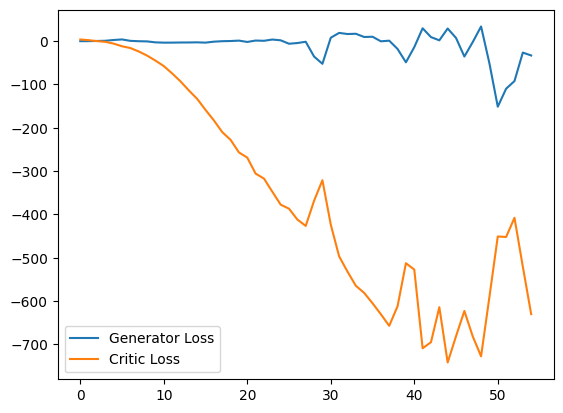

Step 1150: Generator loss: 24.010422983169555, critic loss: -689.6057990722655


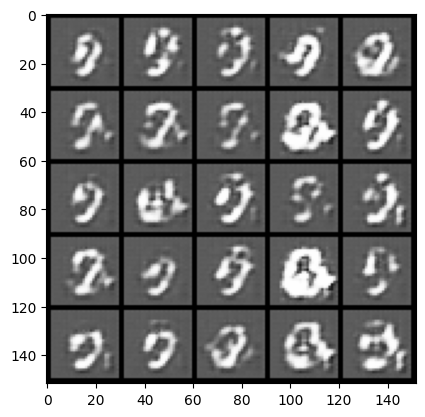

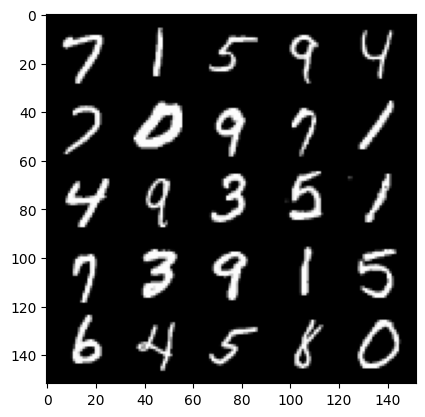

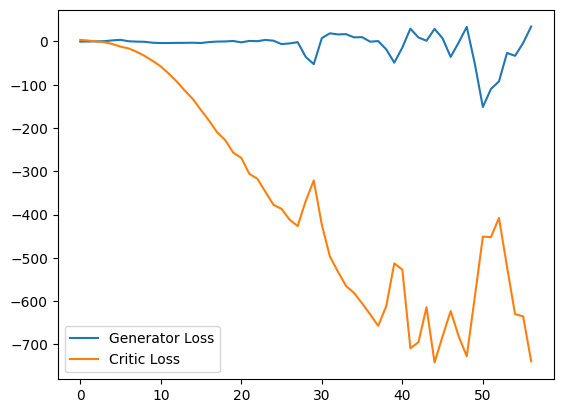

Step 1200: Generator loss: -34.82286451816559, critic loss: -545.176496887207


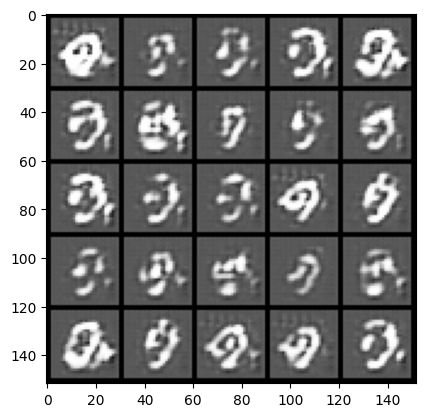

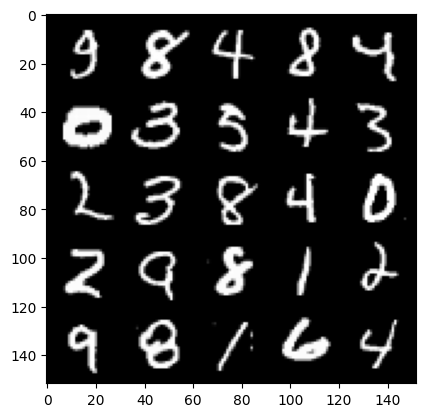

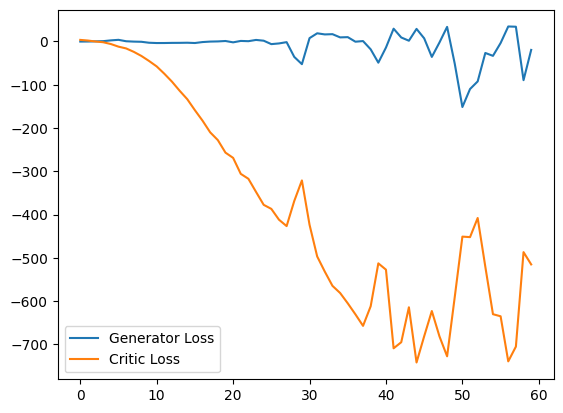

Step 1250: Generator loss: 30.15017763853073, critic loss: -700.5576895141602


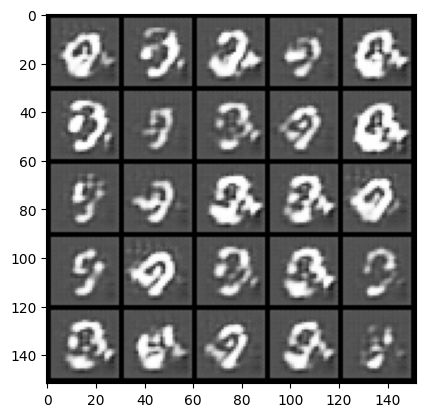

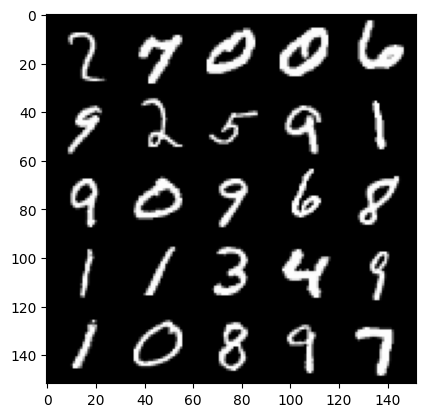

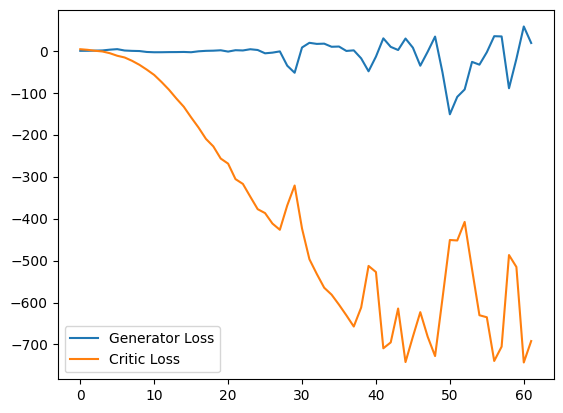

Step 1300: Generator loss: -76.83143997192383, critic loss: -520.9111638793945


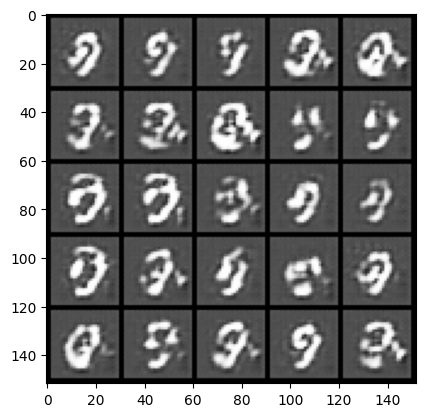

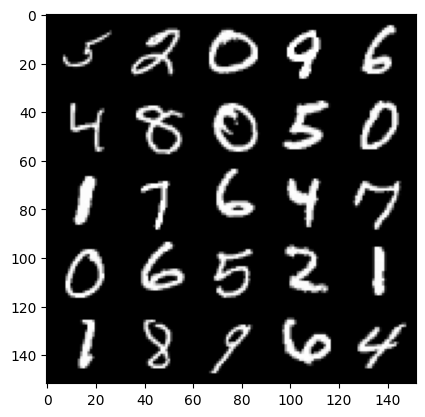

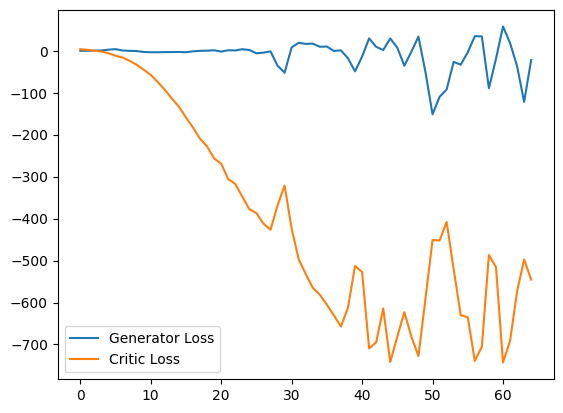

Step 1350: Generator loss: -4.574081461429596, critic loss: -560.466901855469


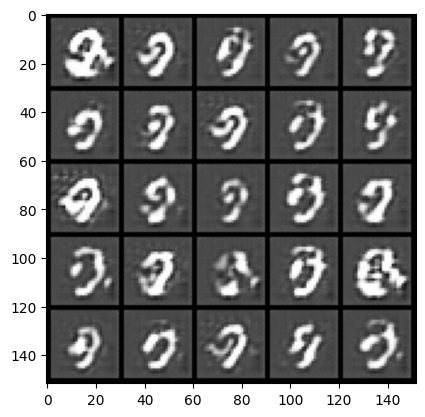

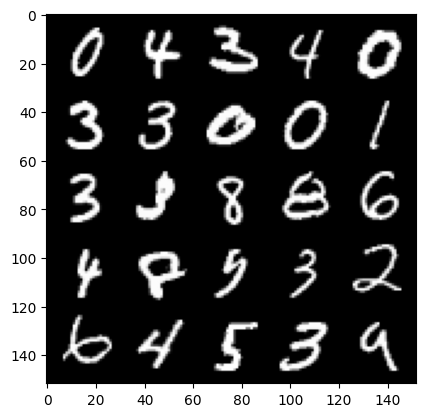

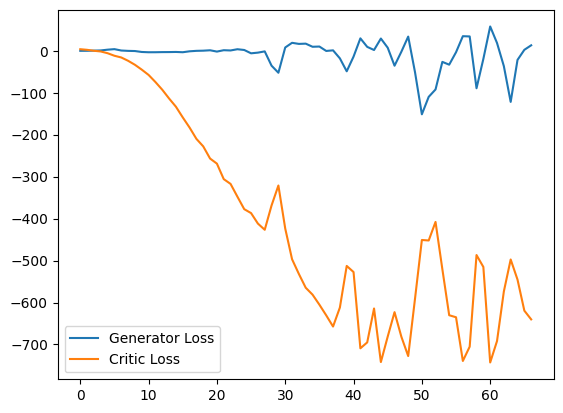

Step 1400: Generator loss: -63.117330040931705, critic loss: -514.0861248779298


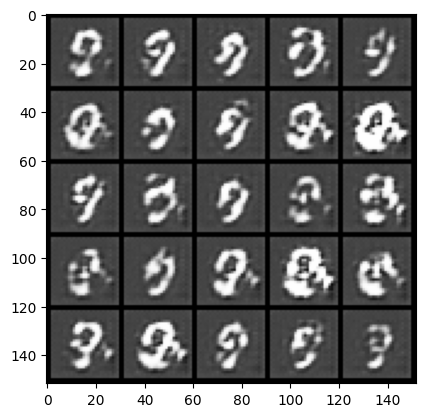

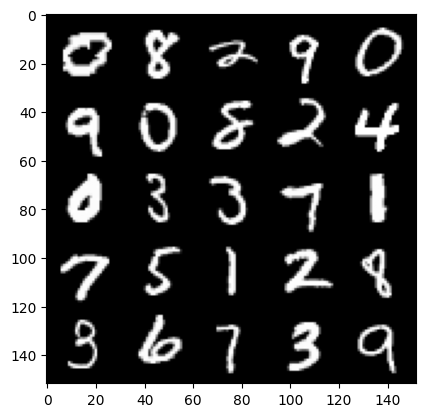

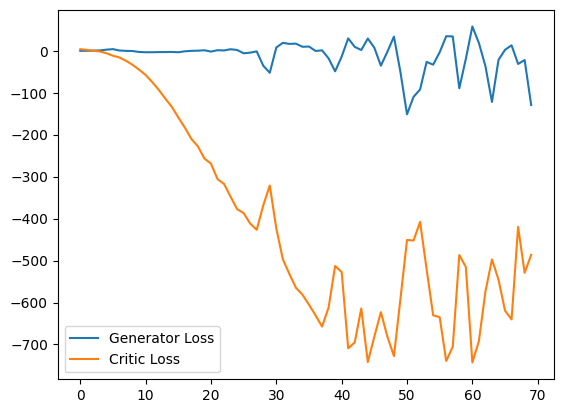

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1450: Generator loss: -94.57064280509948, critic loss: -457.182499420166


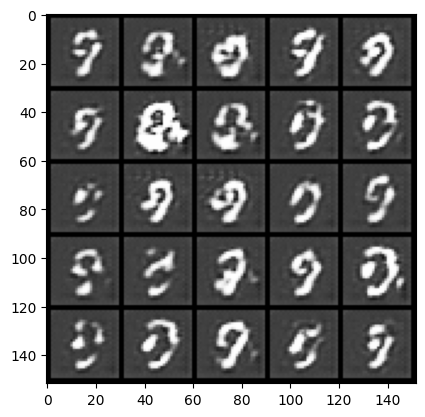

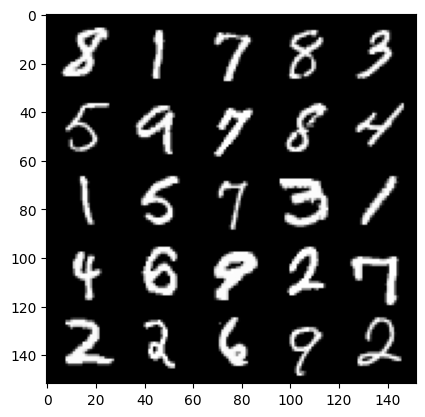

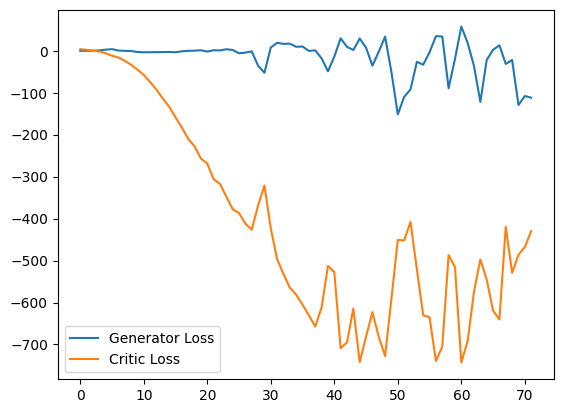

Step 1500: Generator loss: -50.72034659147263, critic loss: -442.2354176330566


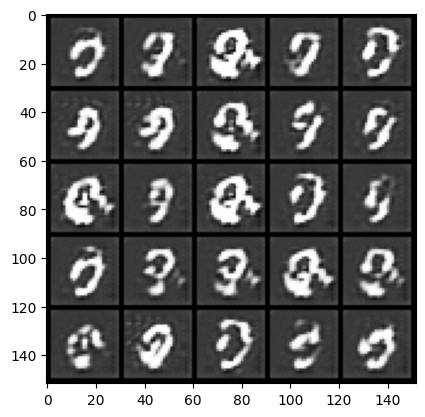

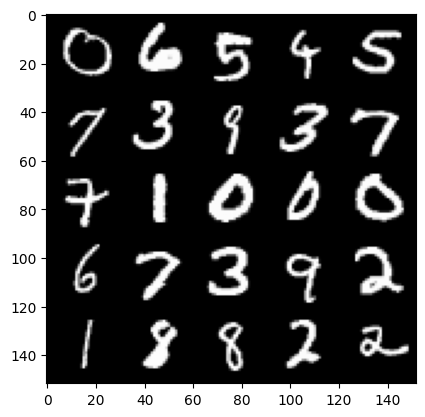

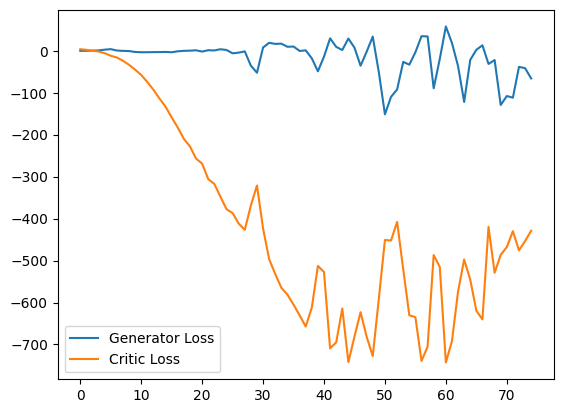

Step 1550: Generator loss: -86.72847394943237, critic loss: -353.6587241516113


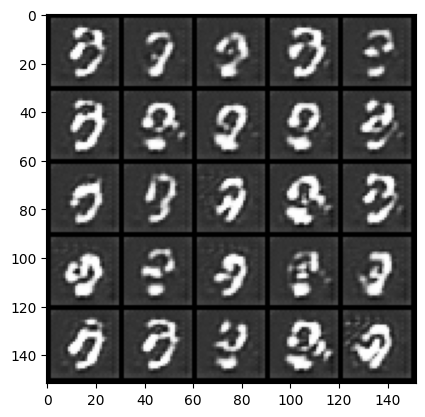

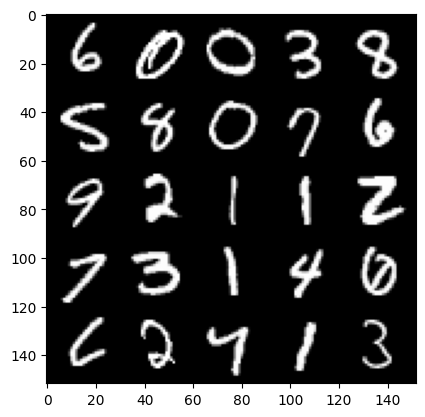

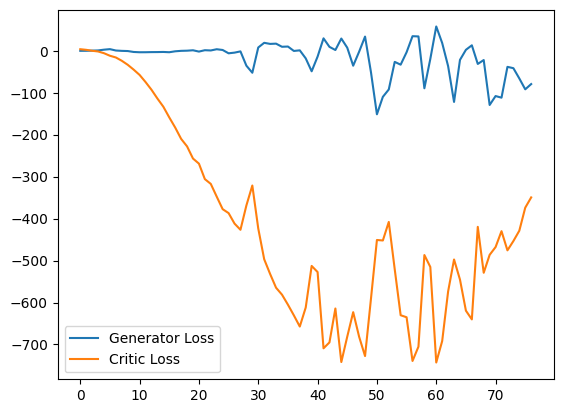

Step 1600: Generator loss: -67.30086524009704, critic loss: -282.42662545776363


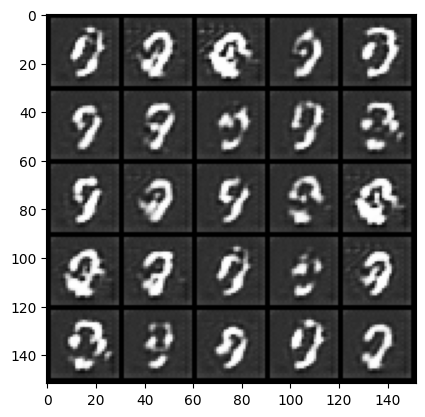

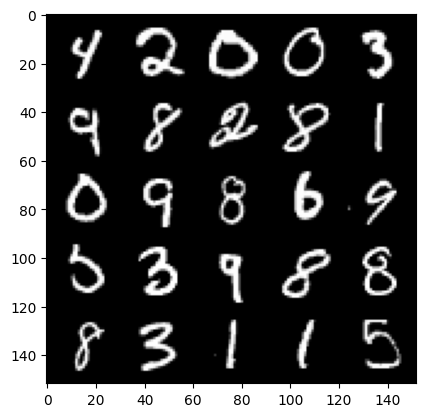

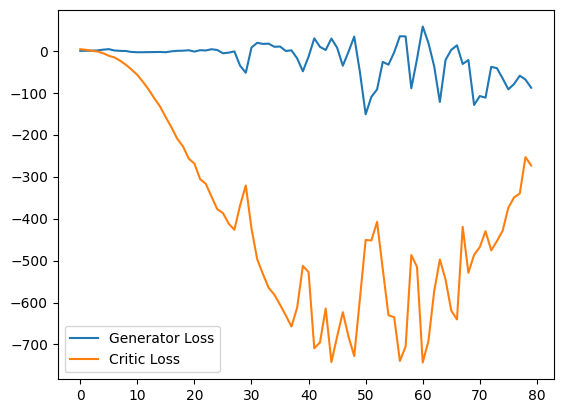

Step 1650: Generator loss: -94.90134066343307, critic loss: -277.03501162719726


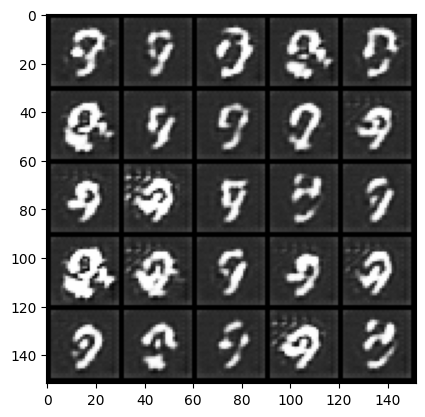

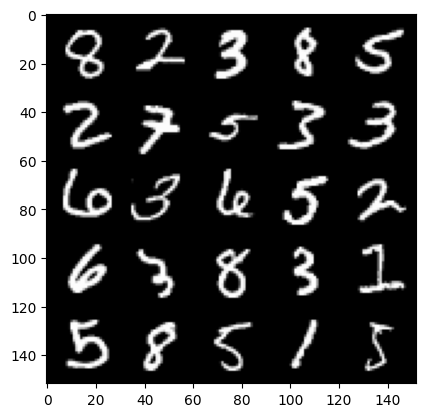

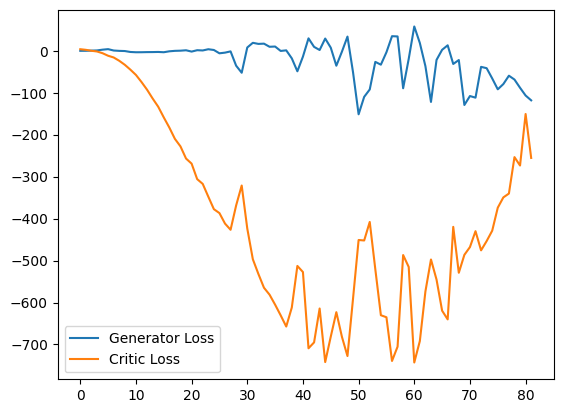

Step 1700: Generator loss: -95.97776473999023, critic loss: -53.91838524246218


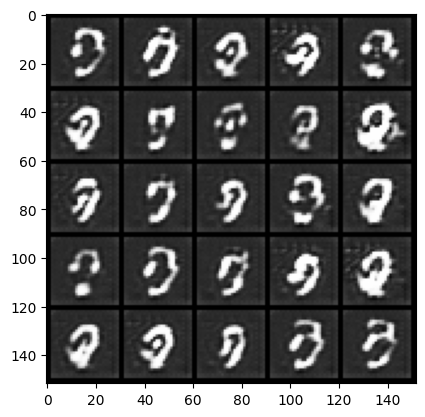

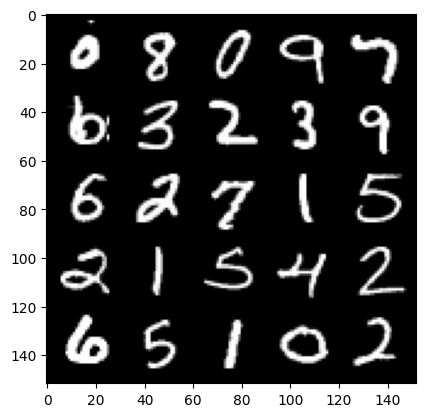

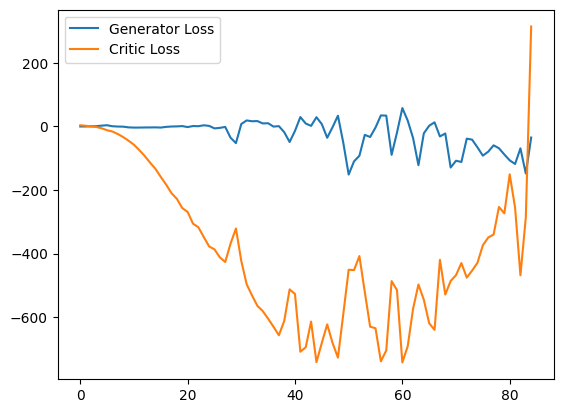

Step 1750: Generator loss: 7.517123355865478, critic loss: 19.043247936248775


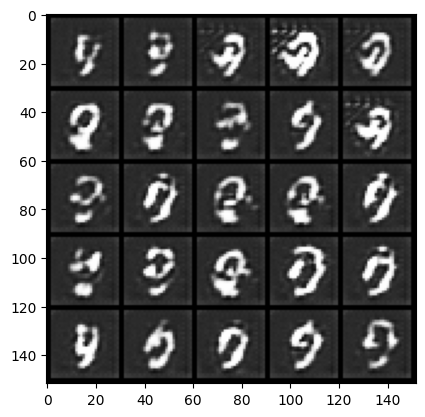

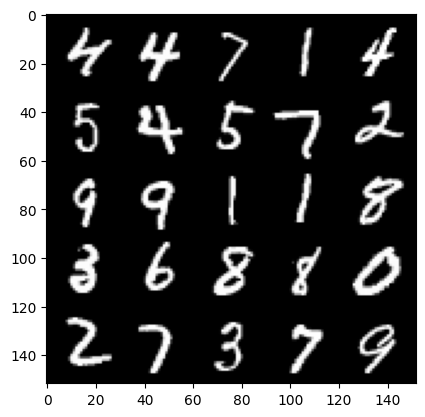

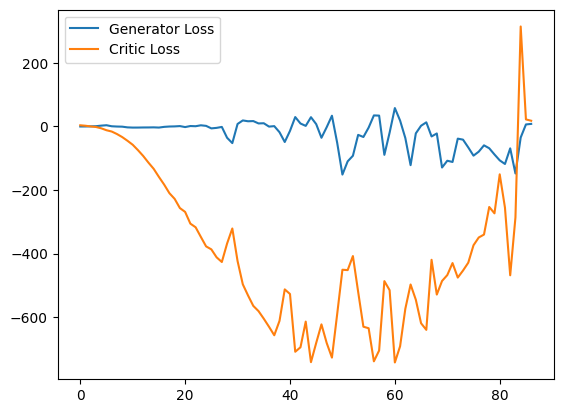

Step 1800: Generator loss: 9.62556318283081, critic loss: 15.37038611602783


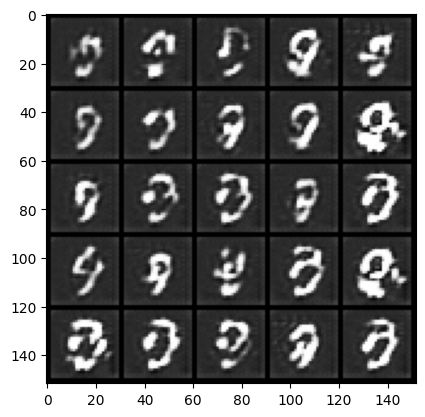

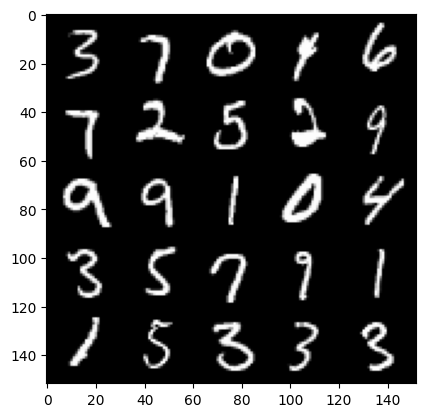

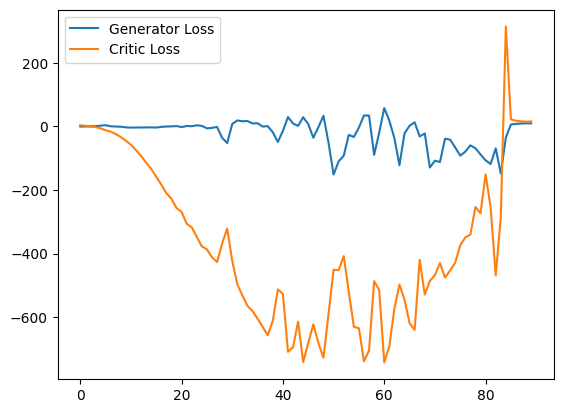

Step 1850: Generator loss: 8.30776282310486, critic loss: 20.461162841796877


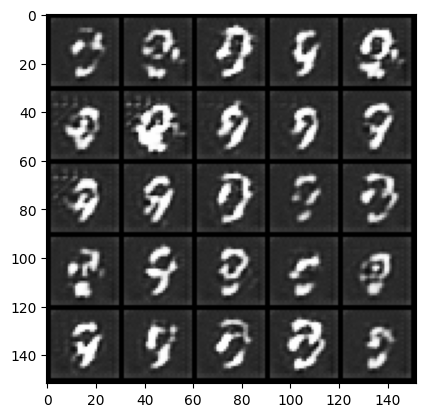

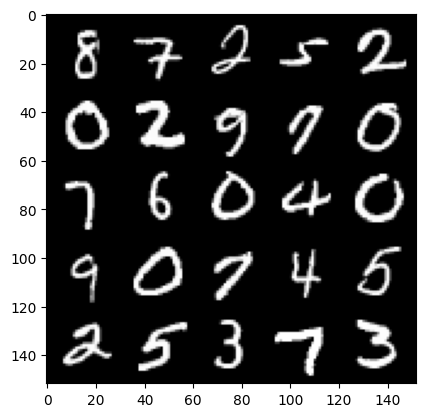

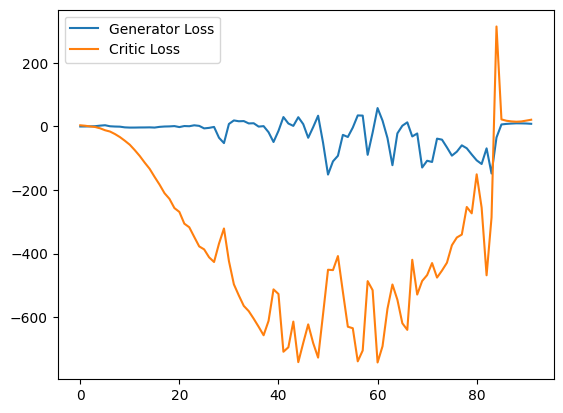

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1900: Generator loss: 4.879226875305176, critic loss: 24.4450805053711


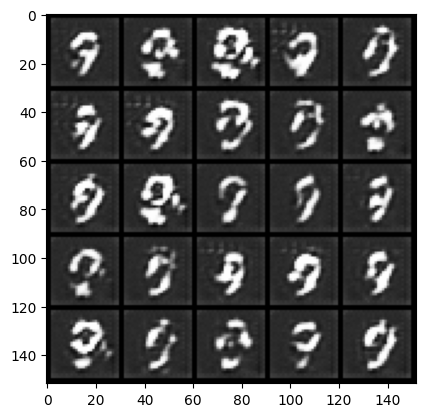

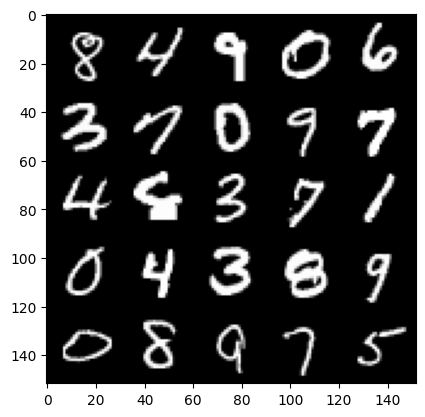

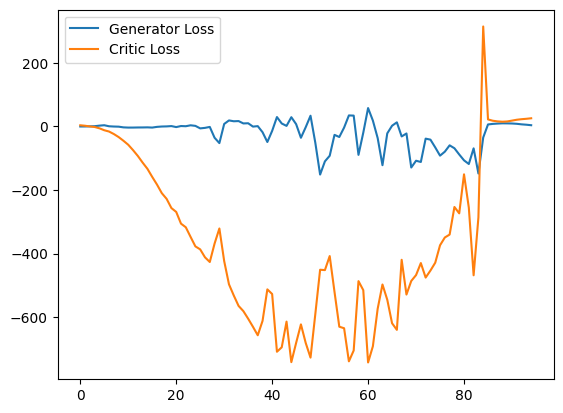

Step 1950: Generator loss: 1.2829851925373077, critic loss: 29.249994720458982


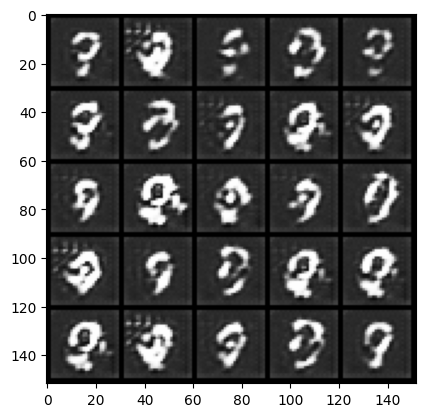

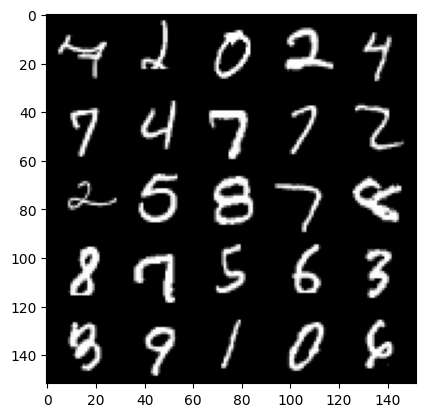

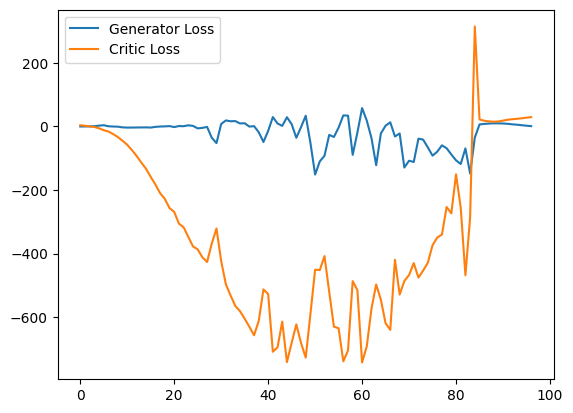

Step 2000: Generator loss: -0.7443834447860718, critic loss: 33.77216225814821


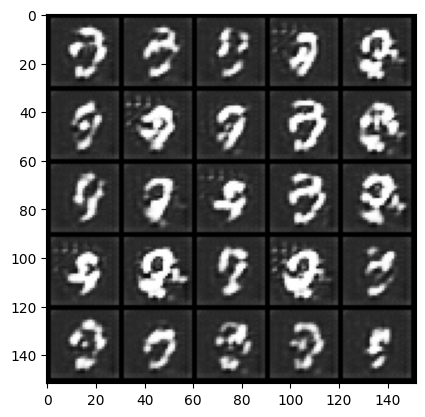

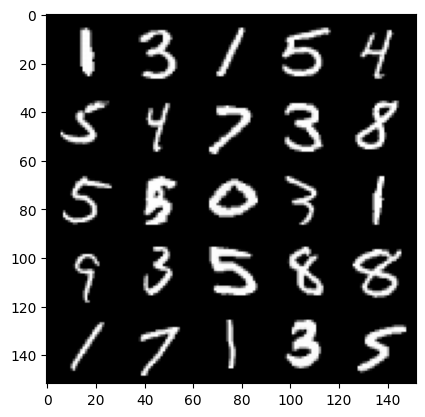

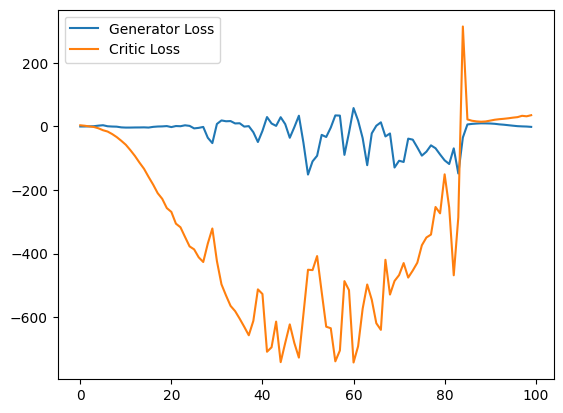

Step 2050: Generator loss: -3.0868023252487182, critic loss: 36.78287540435792


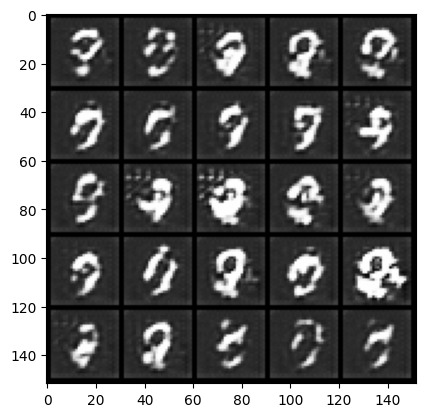

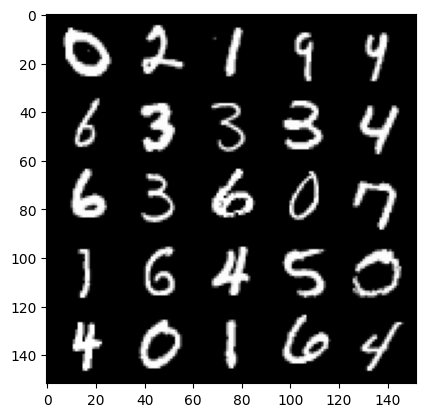

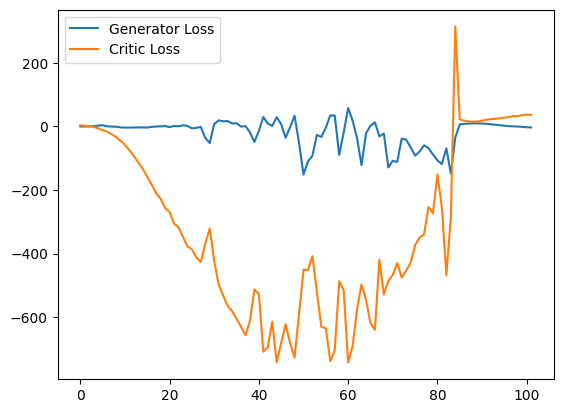

Step 2100: Generator loss: -4.8534414148330685, critic loss: 34.59904863739014


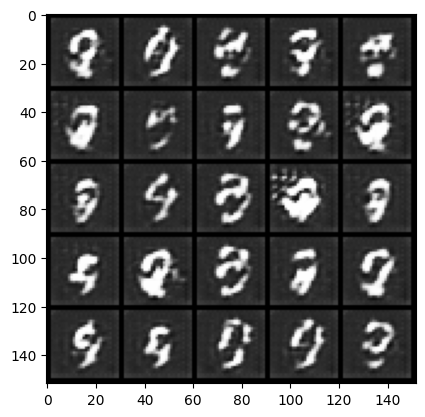

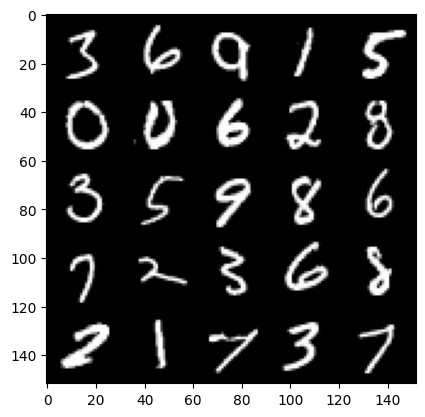

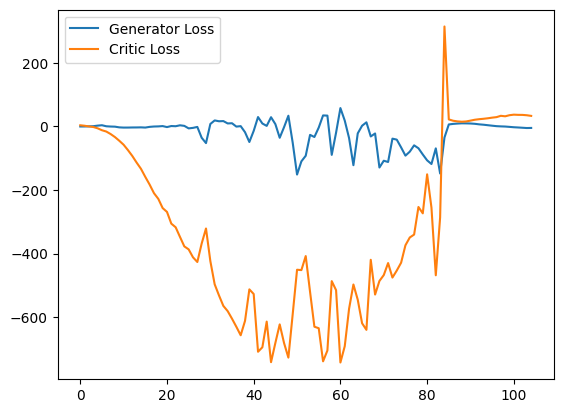

Step 2150: Generator loss: -5.046793580055237, critic loss: 34.317239395141584


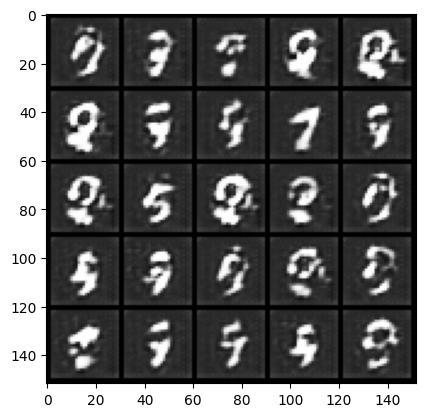

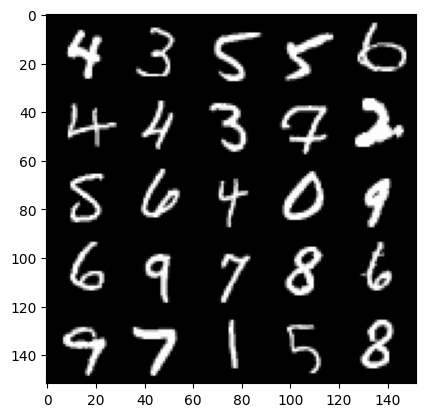

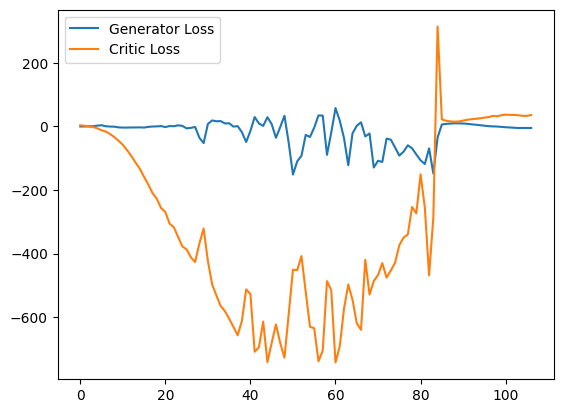

Step 2200: Generator loss: -8.06173038482666, critic loss: 34.68145654296876


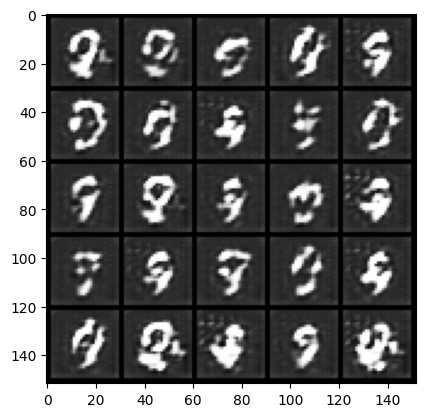

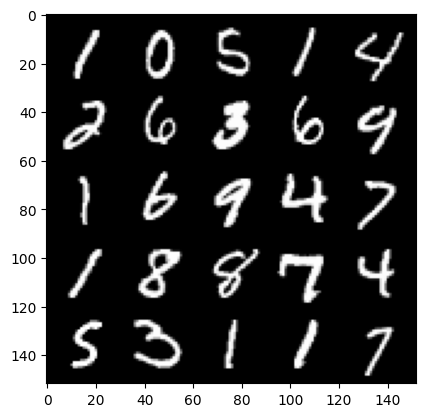

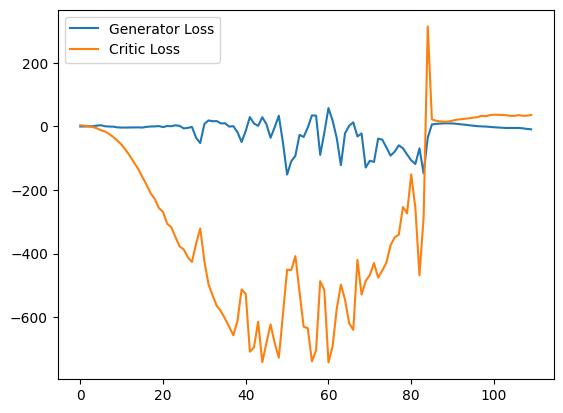

Step 2250: Generator loss: -7.952916355133056, critic loss: 37.69819673156741


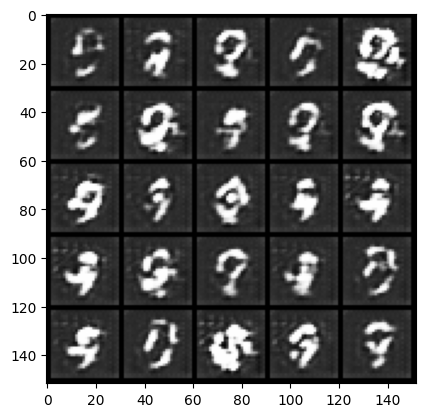

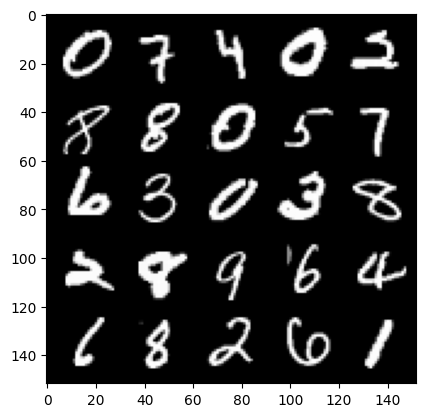

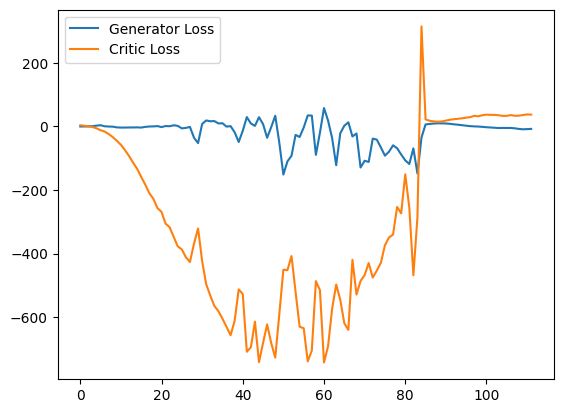

Step 2300: Generator loss: -8.21015917778015, critic loss: 38.611864112854


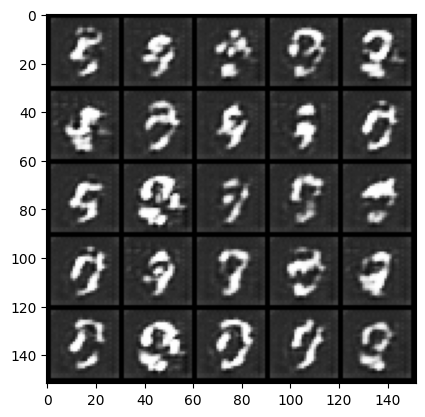

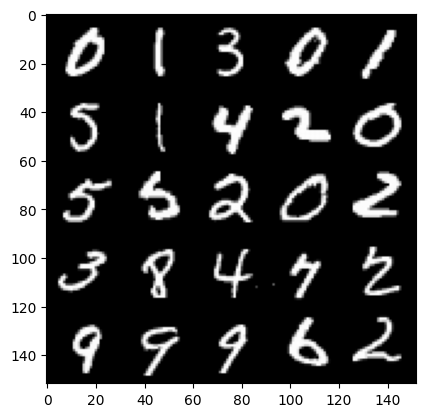

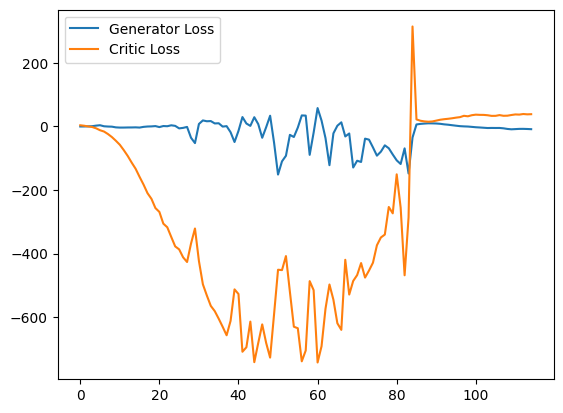

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2350: Generator loss: -9.546804094314576, critic loss: 37.060506706237796


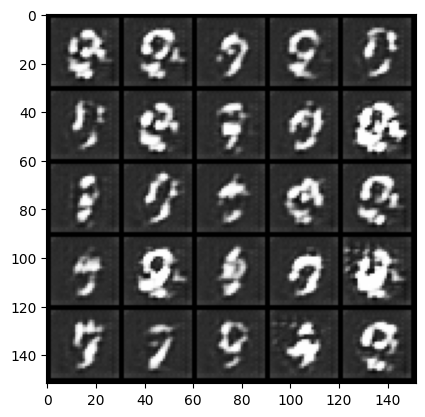

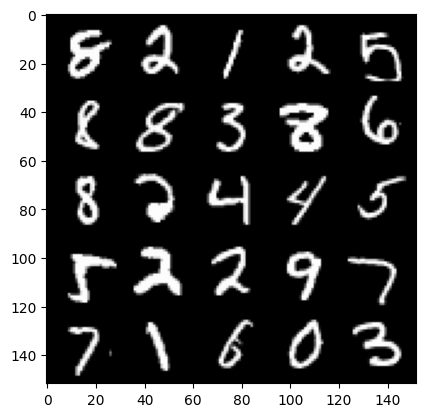

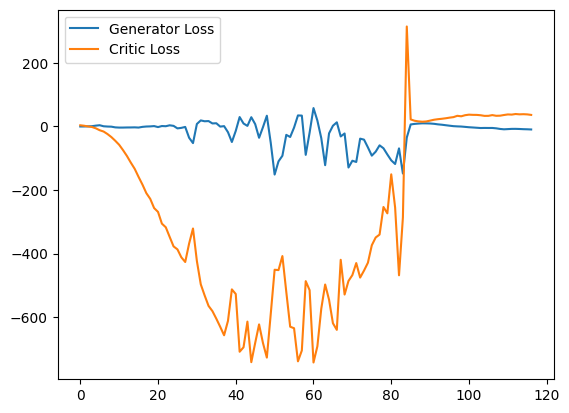

Step 2400: Generator loss: -12.20825927734375, critic loss: 35.73108470153809


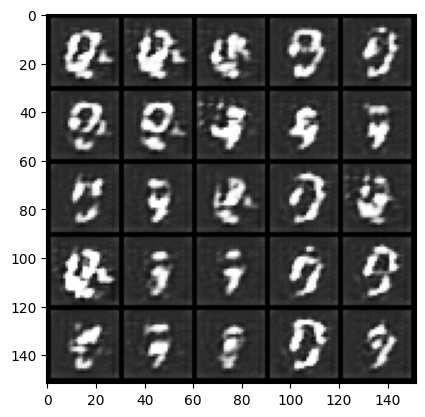

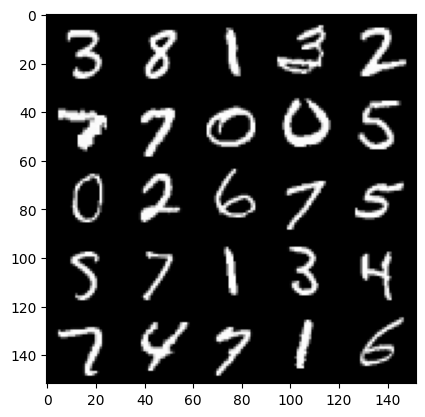

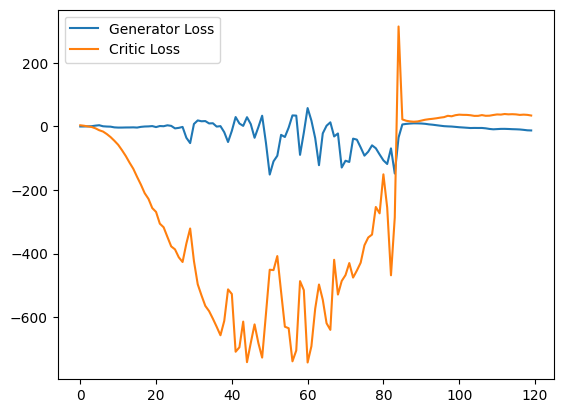

Step 2450: Generator loss: -13.240833778381347, critic loss: 34.69309136962892


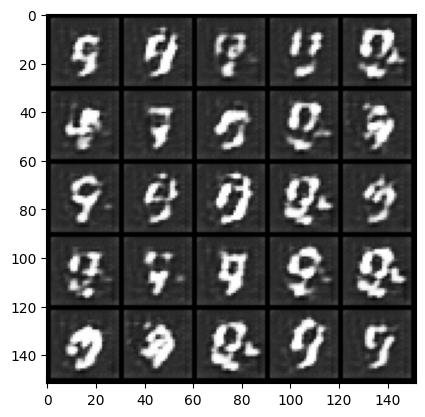

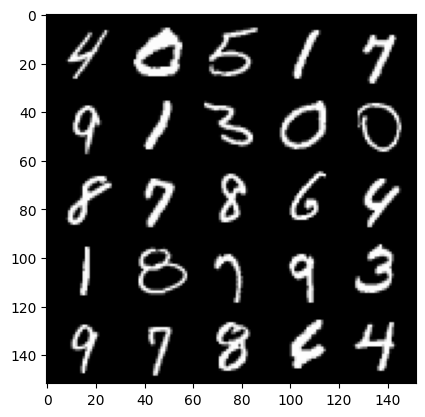

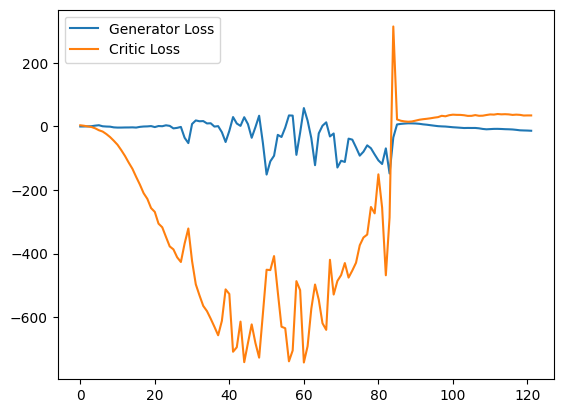

Step 2500: Generator loss: -12.473562622070313, critic loss: 33.59814721679688


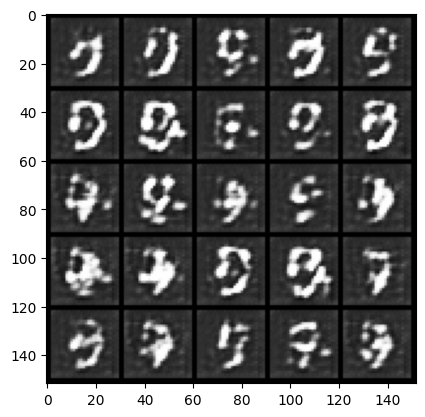

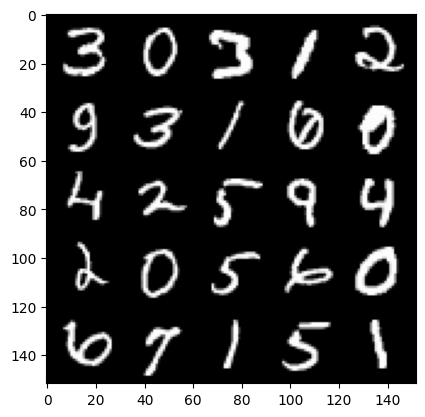

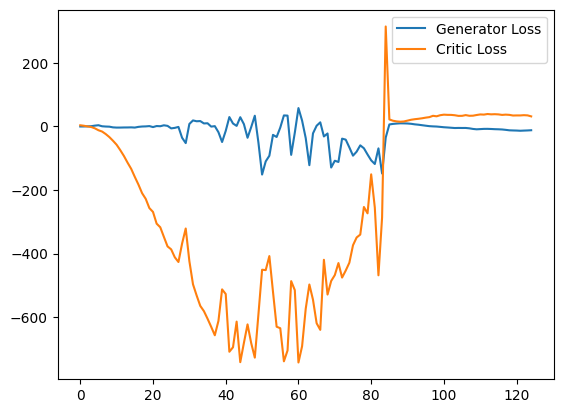

Step 2550: Generator loss: -11.386247234344482, critic loss: 26.44323097991944


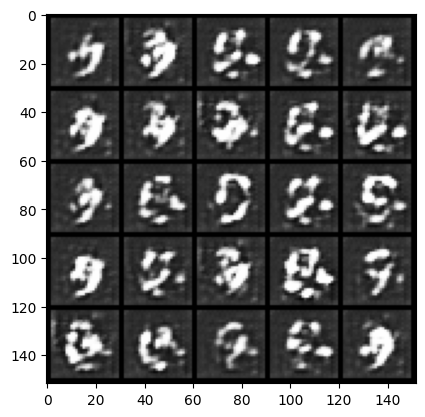

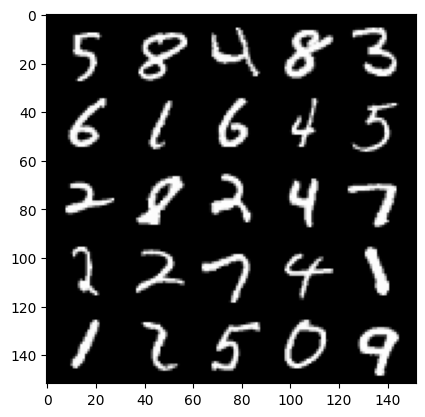

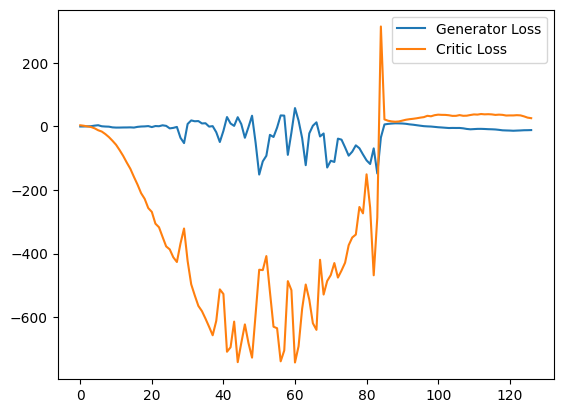

Step 2600: Generator loss: -10.581899003982544, critic loss: 18.809969020843504


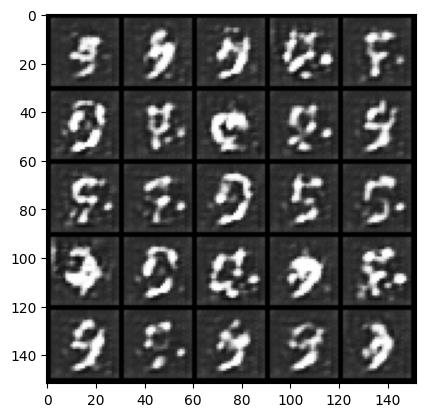

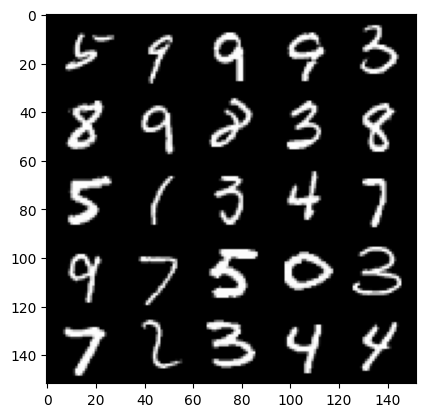

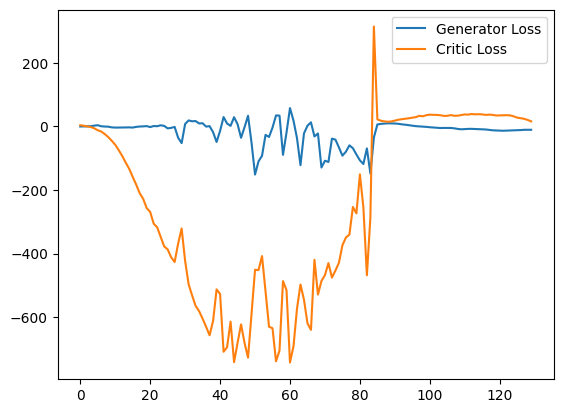

Step 2650: Generator loss: -10.690501251220702, critic loss: 10.023337074279784


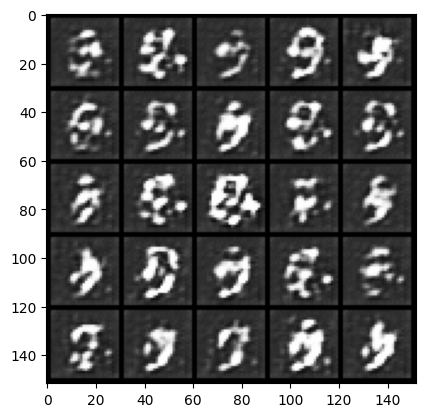

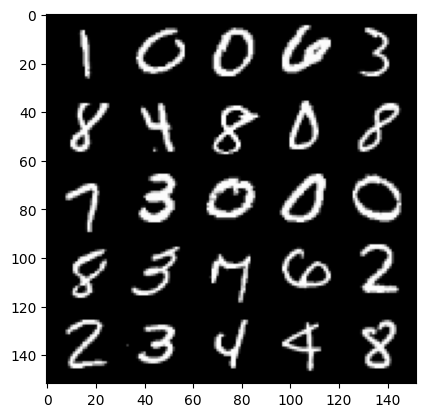

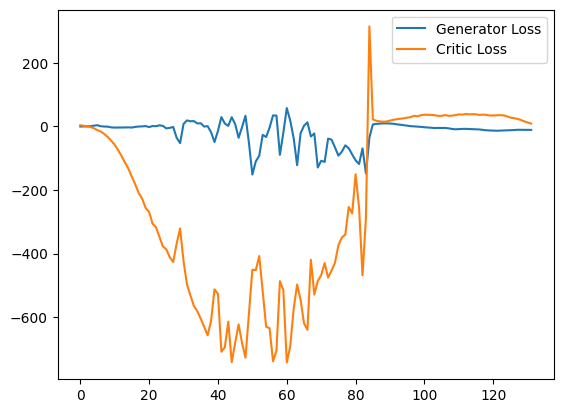

Step 2700: Generator loss: -7.670000948905945, critic loss: 5.943403526306155


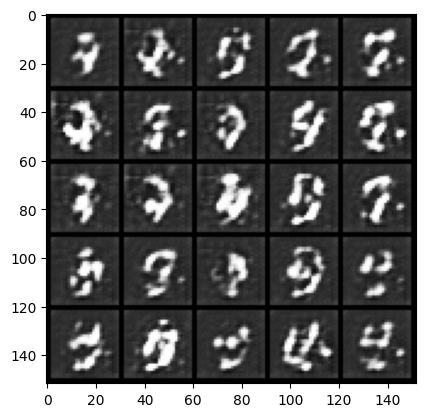

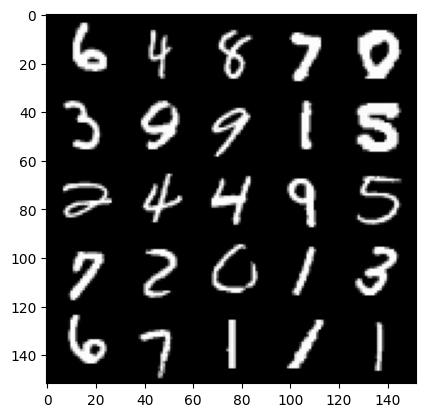

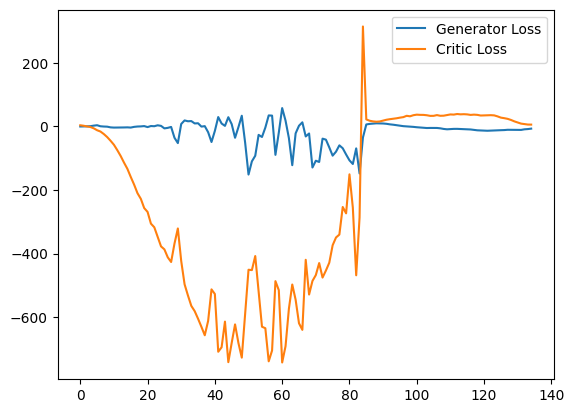

Step 2750: Generator loss: -5.996178684234619, critic loss: 5.026933296203612


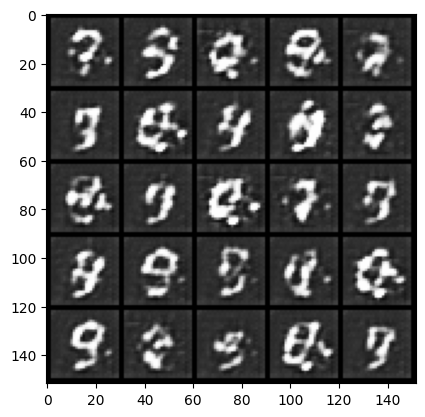

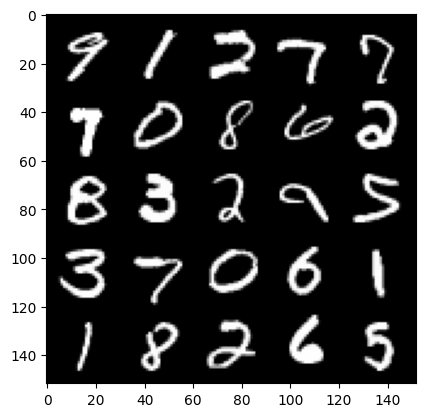

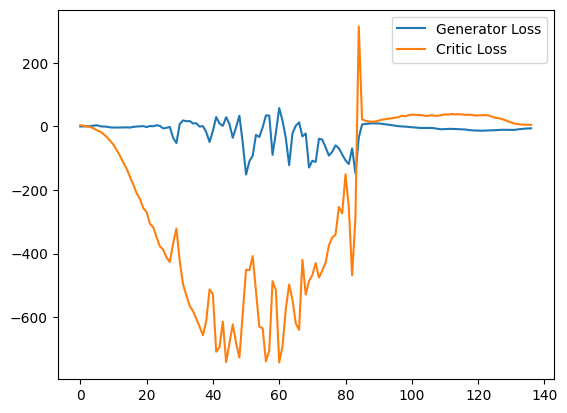

Step 2800: Generator loss: -5.606602599620819, critic loss: 3.3790177230834963


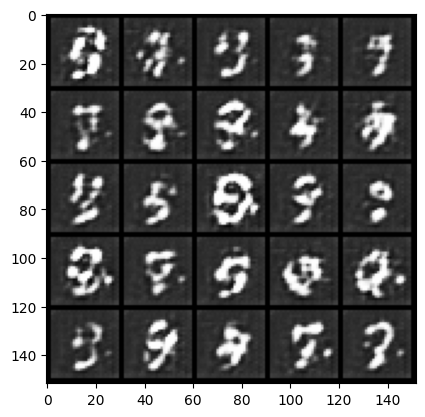

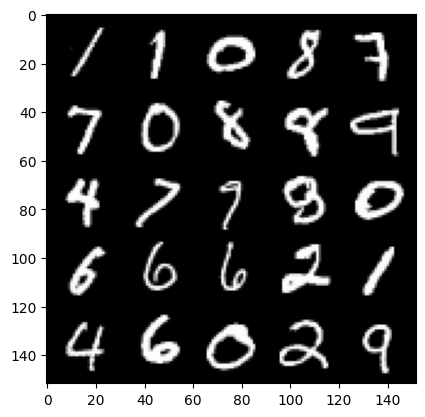

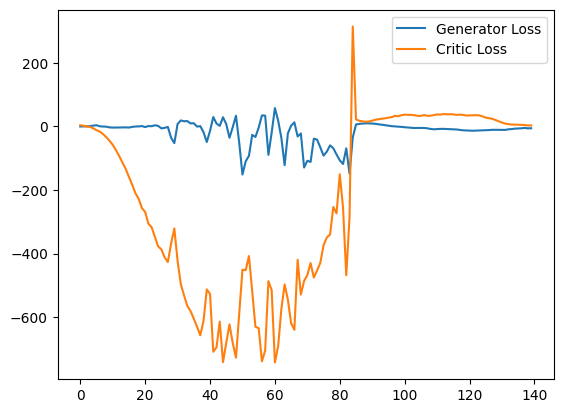

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2850: Generator loss: -4.622030221223831, critic loss: 2.1168606262207033


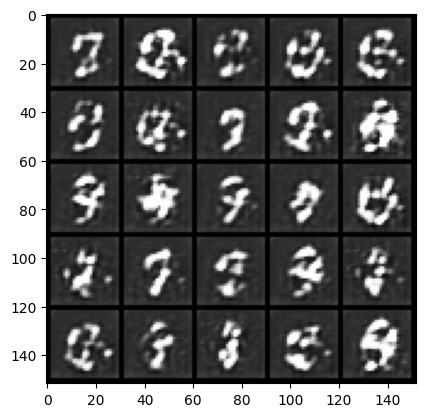

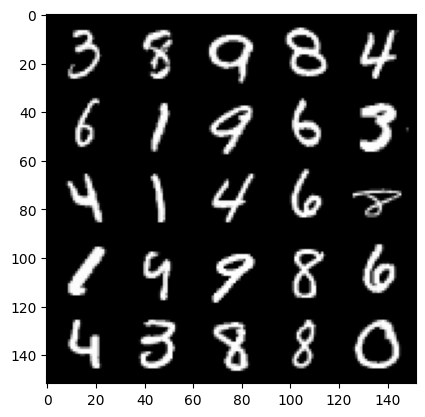

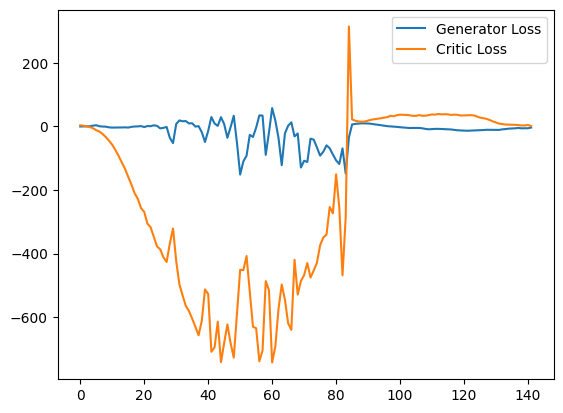

Step 2900: Generator loss: -3.4115075820684435, critic loss: -1.4323535079956056


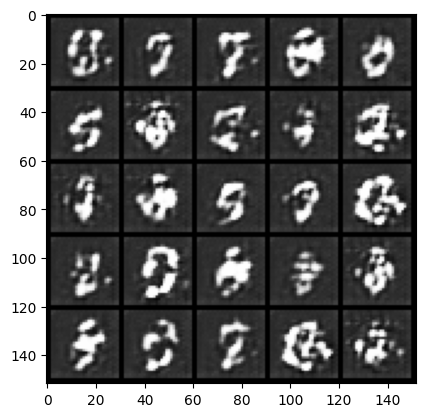

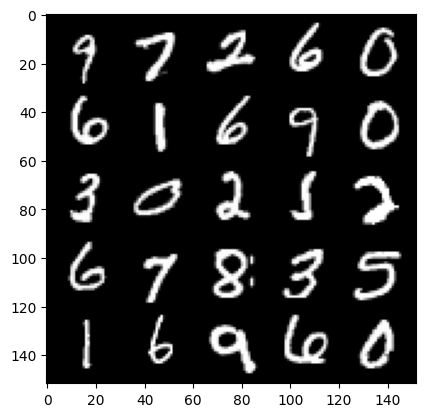

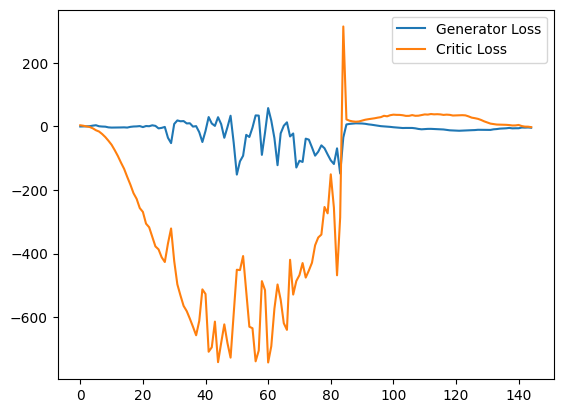

Step 2950: Generator loss: -4.507757370173931, critic loss: -4.753596611022949


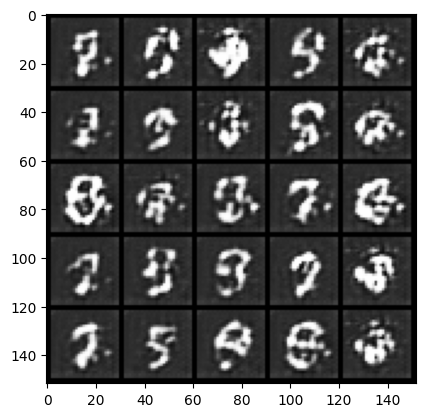

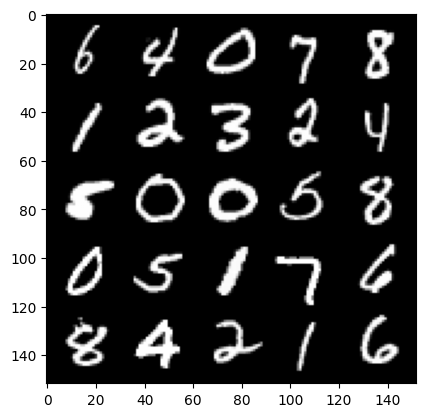

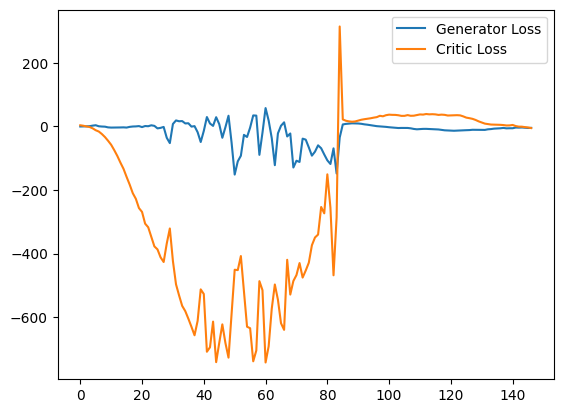

Step 3000: Generator loss: -2.3702788943052293, critic loss: -4.972099136352539


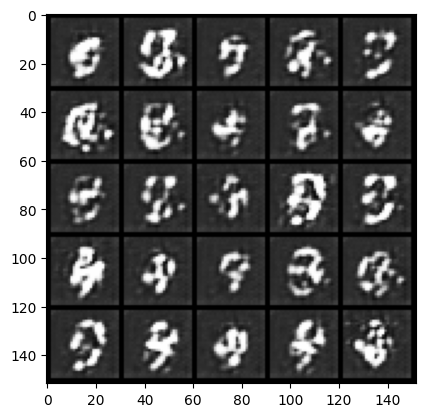

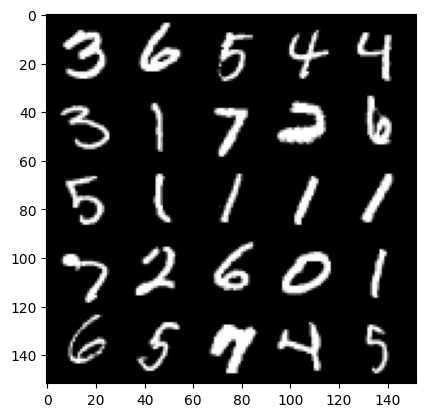

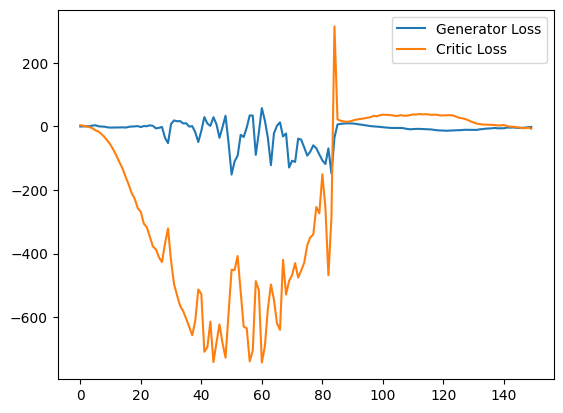

Step 3050: Generator loss: -2.9256876549124717, critic loss: -6.622335266113281


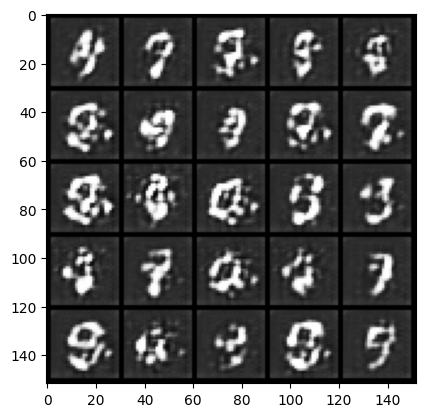

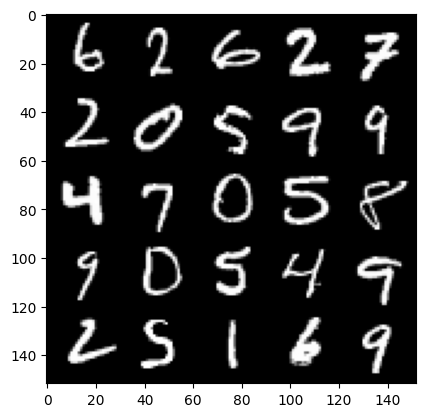

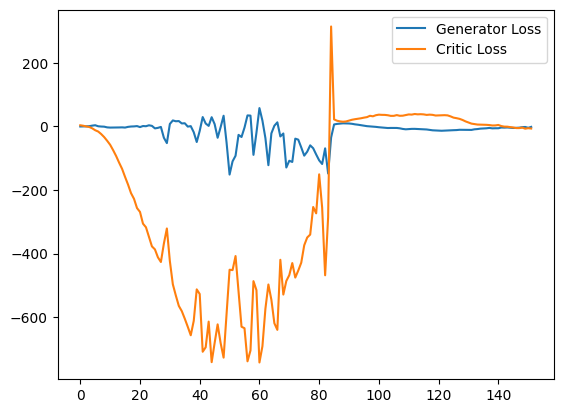

Step 3100: Generator loss: -1.1927945396304132, critic loss: -8.975933113098142


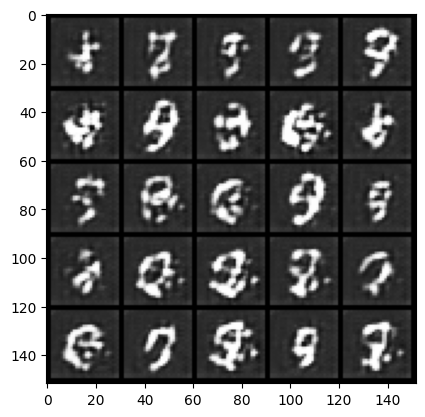

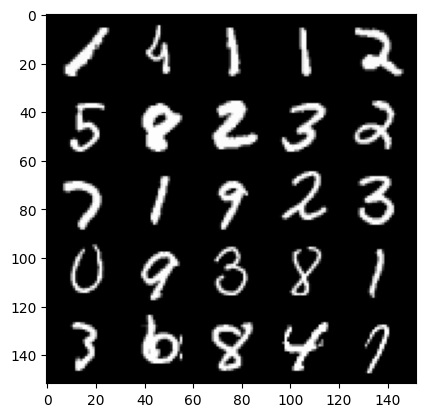

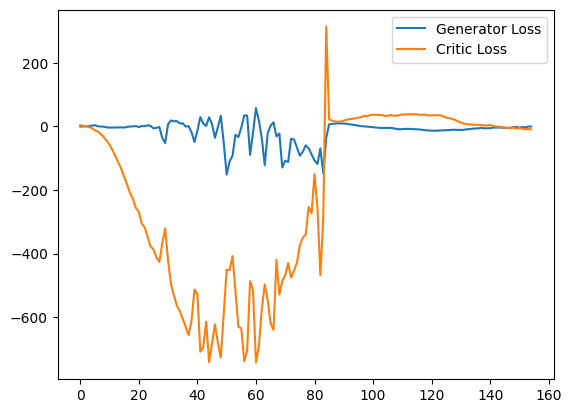

Step 3150: Generator loss: -1.0555299669504166, critic loss: -8.657973068237304


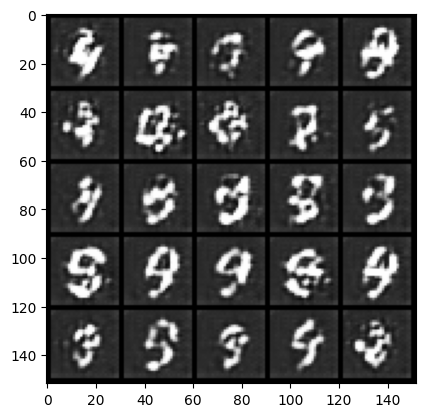

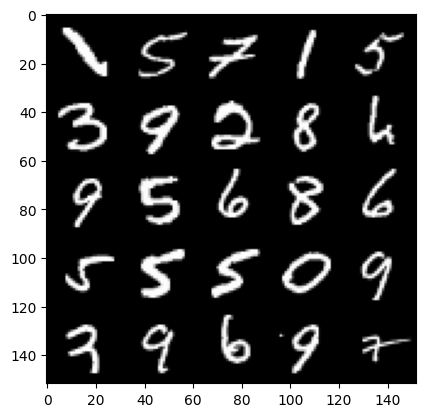

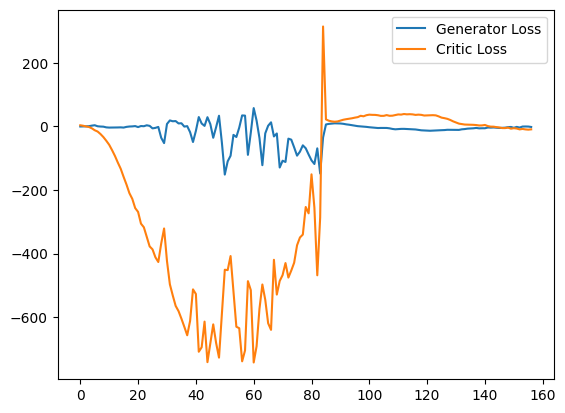

Step 3200: Generator loss: 0.937488976418972, critic loss: -12.609279953002929


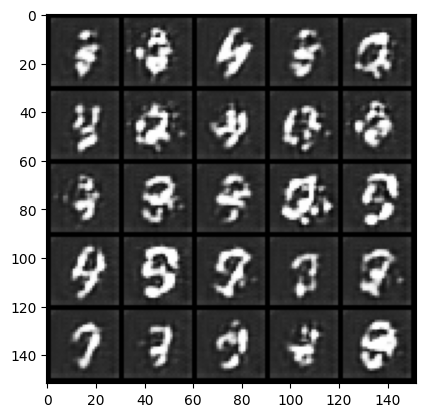

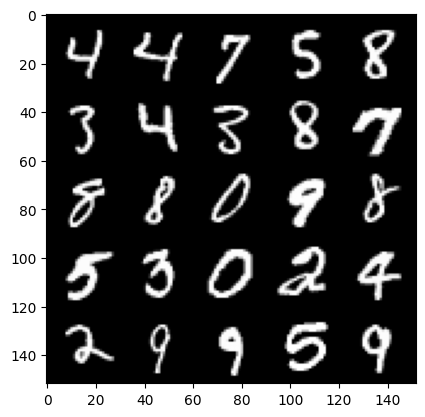

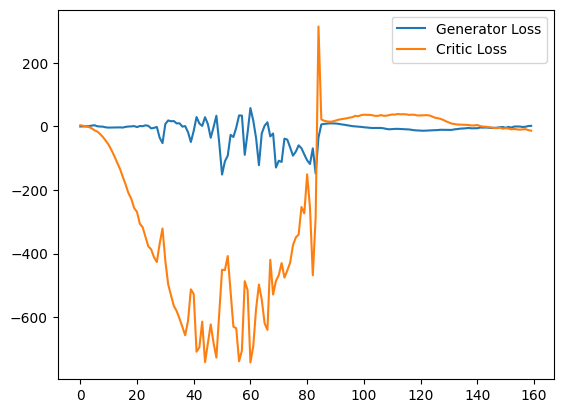

Step 3250: Generator loss: 0.5873056417703628, critic loss: -9.820313224792482


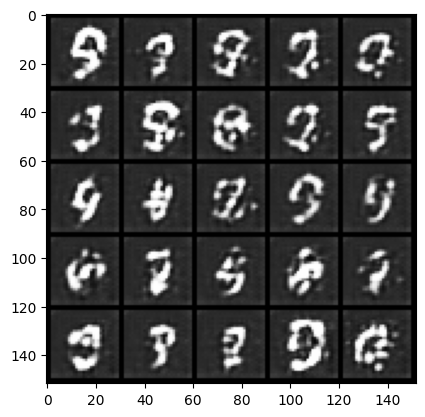

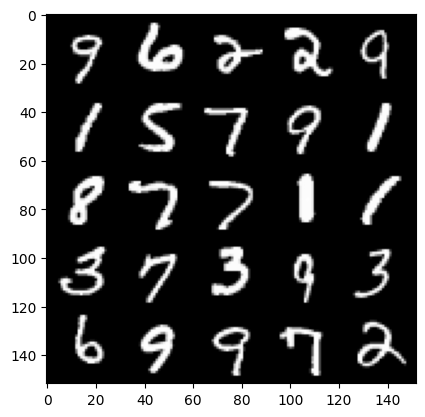

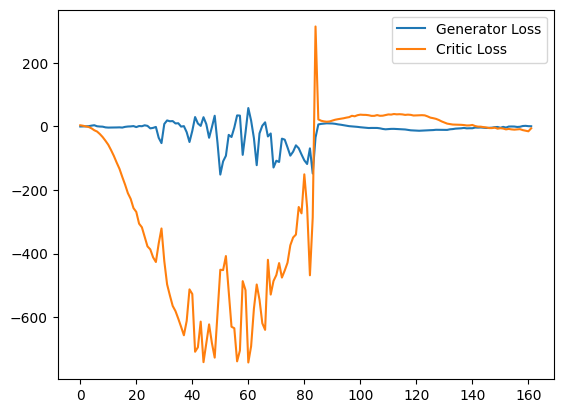

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3300: Generator loss: 3.1135003128647805, critic loss: -14.590659301757814


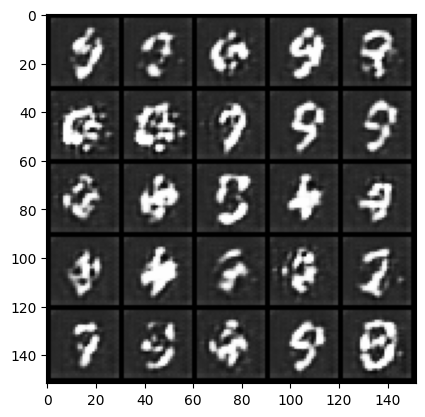

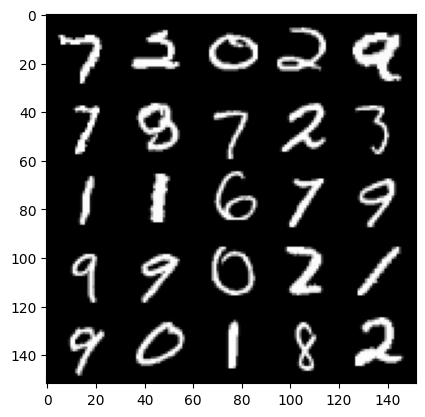

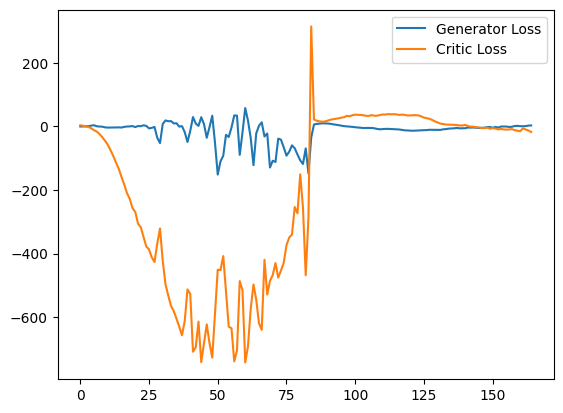

Step 3350: Generator loss: -1.5233972817659378, critic loss: -15.356995121002202


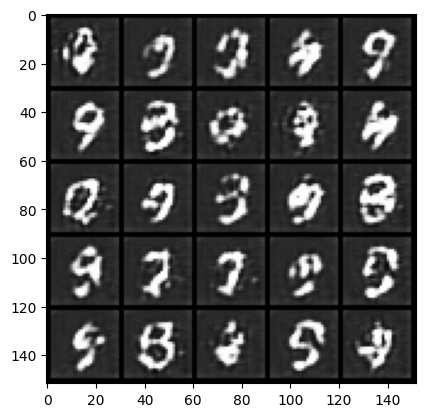

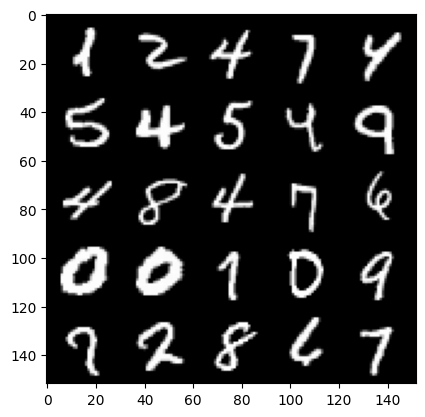

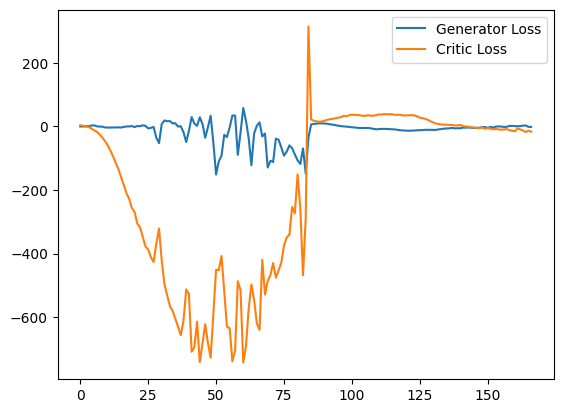

Step 3400: Generator loss: 0.6554674175381661, critic loss: -17.654504119873042


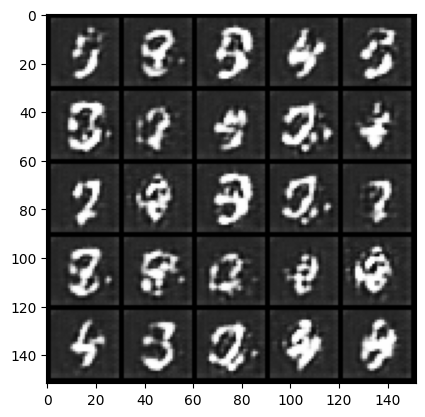

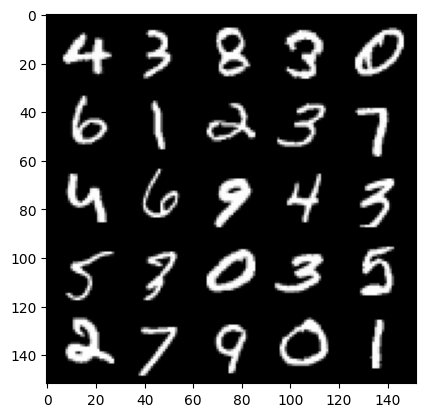

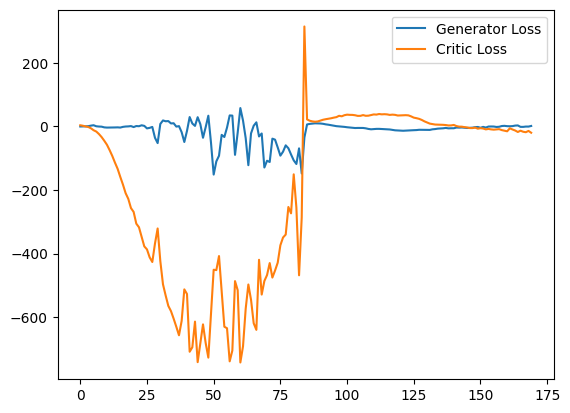

Step 3450: Generator loss: 2.6983625385165215, critic loss: -21.7290097579956


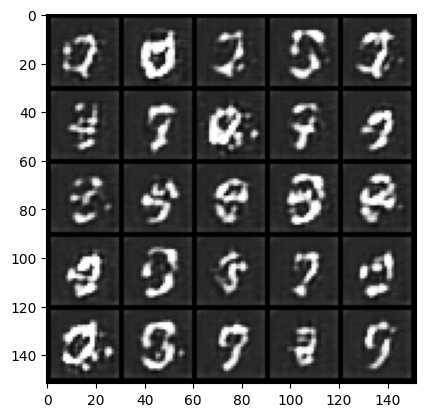

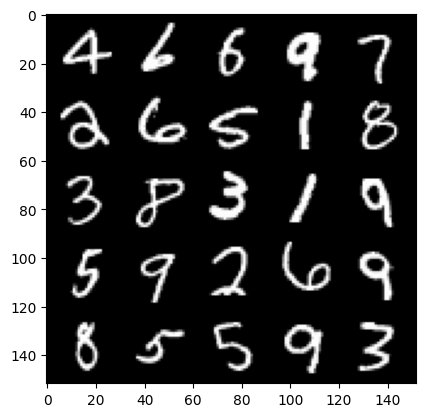

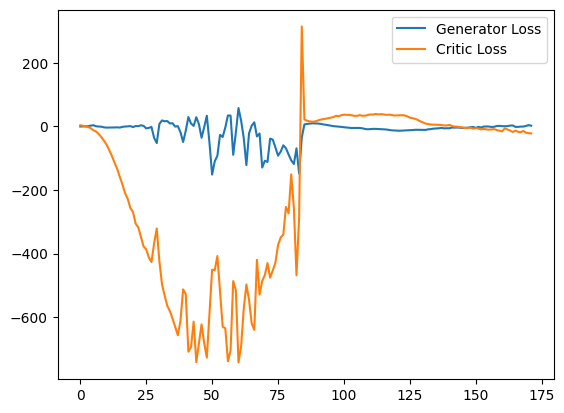

Step 3500: Generator loss: 3.5566893011331557, critic loss: -25.45782155227661


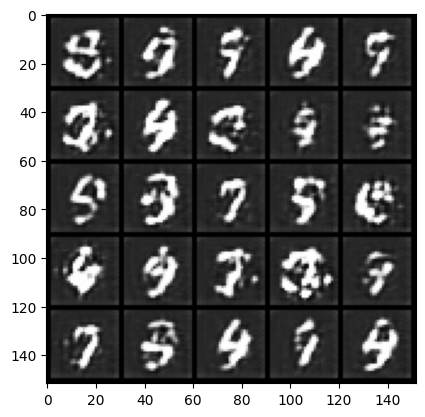

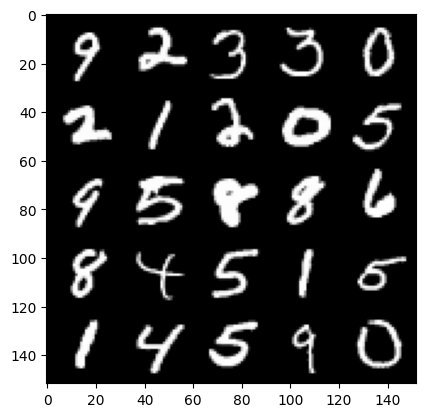

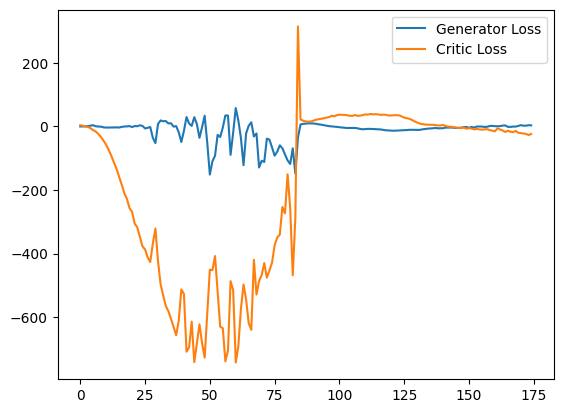

Step 3550: Generator loss: 3.1793831992149353, critic loss: -1.8114968585968034


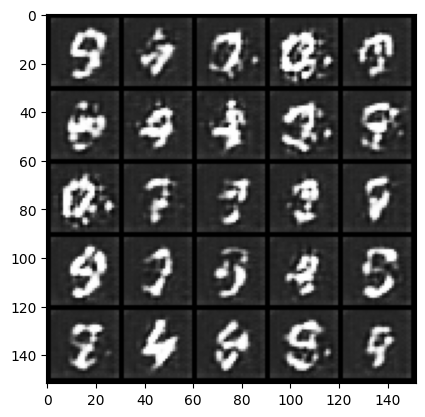

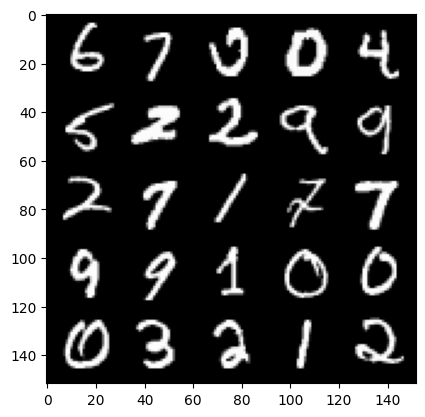

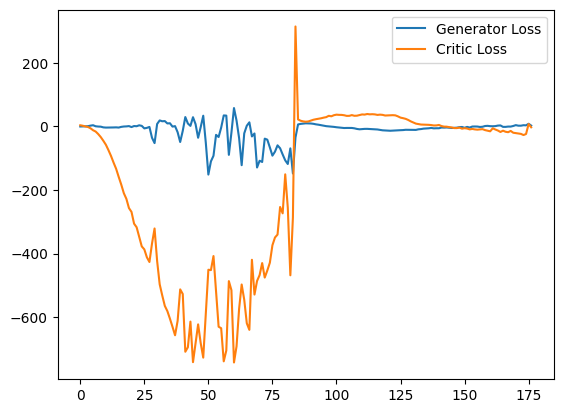

Step 3600: Generator loss: -7.023494536876679, critic loss: -22.77715148544312


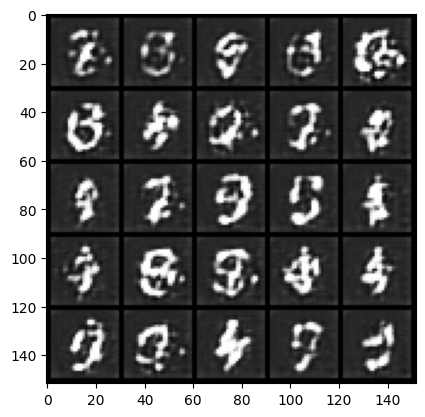

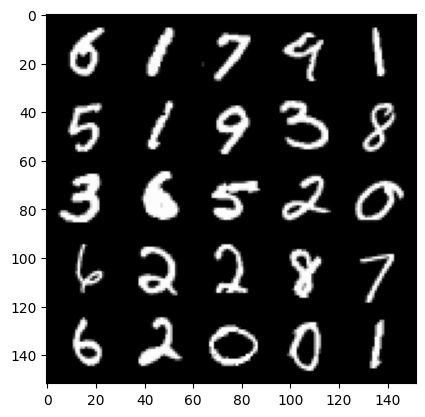

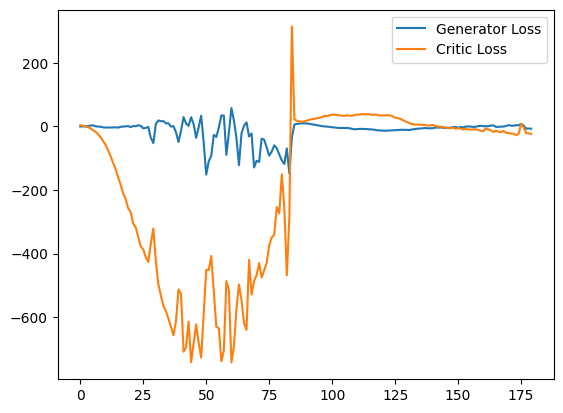

Step 3650: Generator loss: -3.824596917182207, critic loss: -24.995053779602046


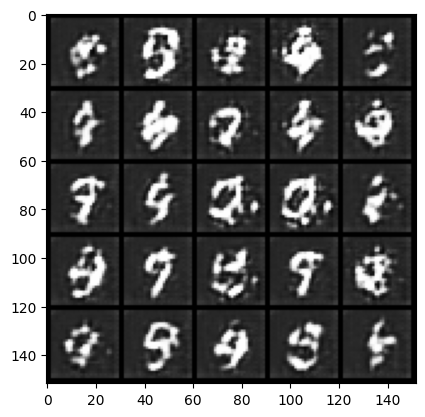

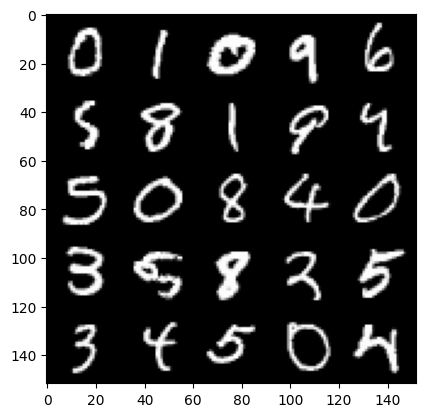

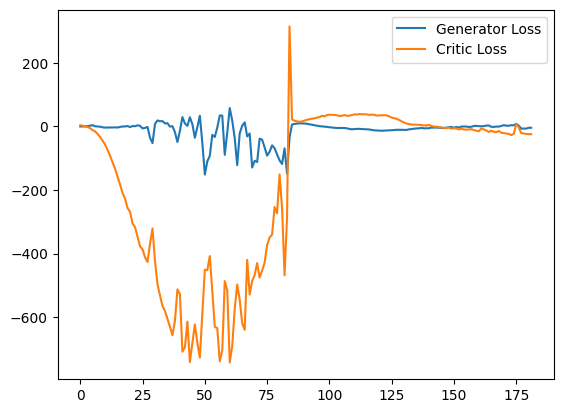

Step 3700: Generator loss: -2.588045418858528, critic loss: -27.734206954956058


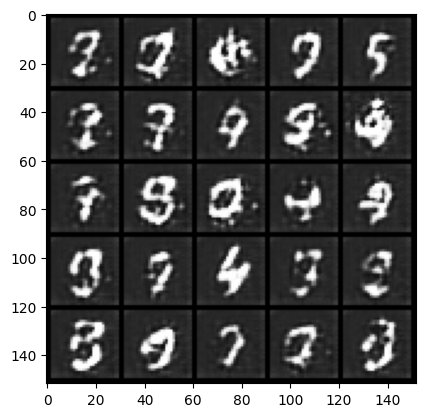

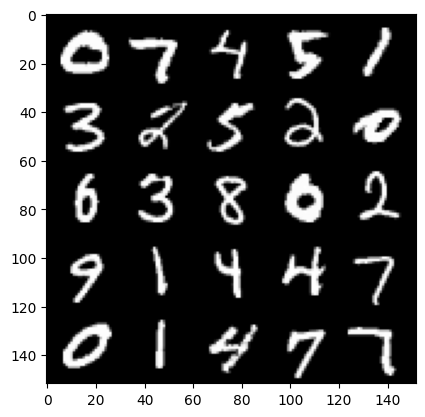

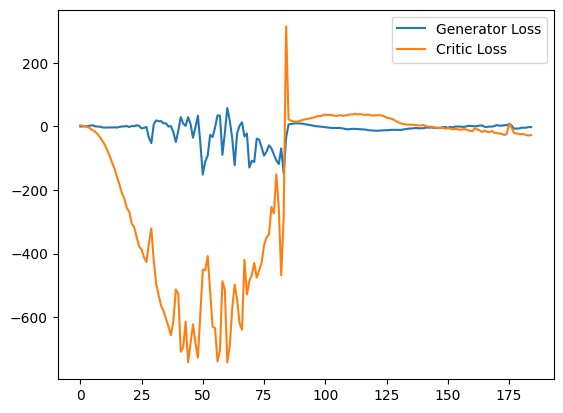

Step 3750: Generator loss: 2.056357480585575, critic loss: -29.16240134811401


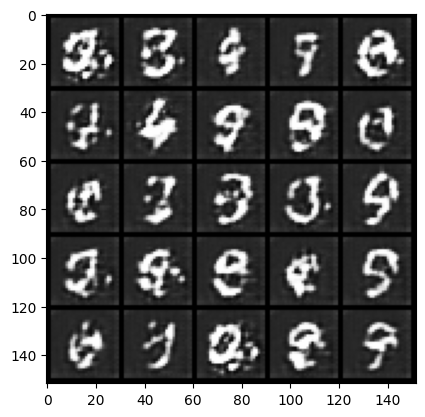

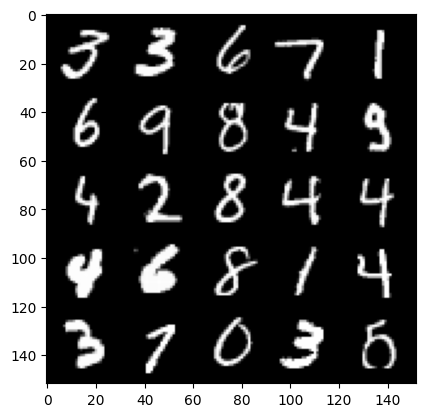

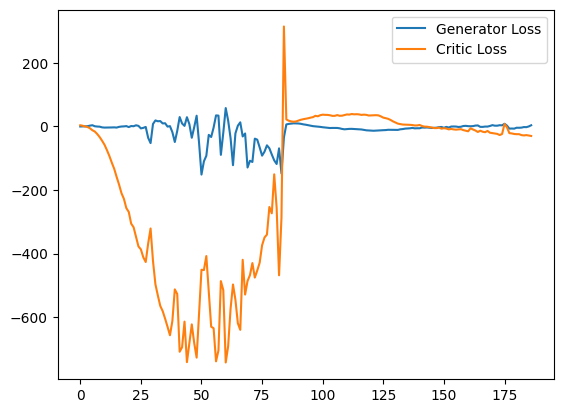

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3800: Generator loss: 3.035521108210087, critic loss: -29.390748291015633


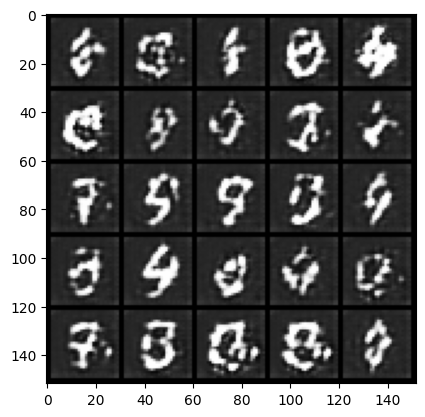

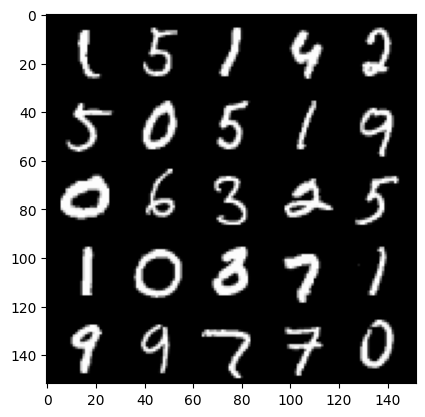

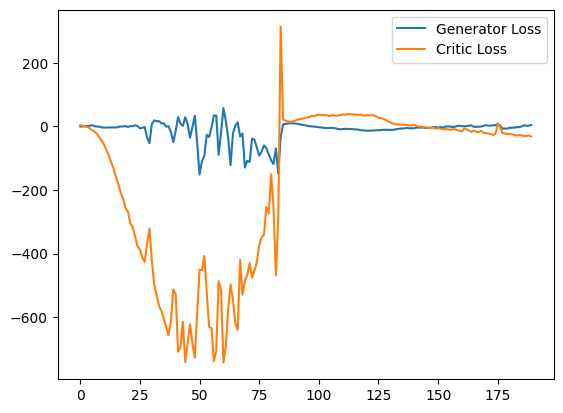

Step 3850: Generator loss: 3.175031896829605, critic loss: -31.980269002914437


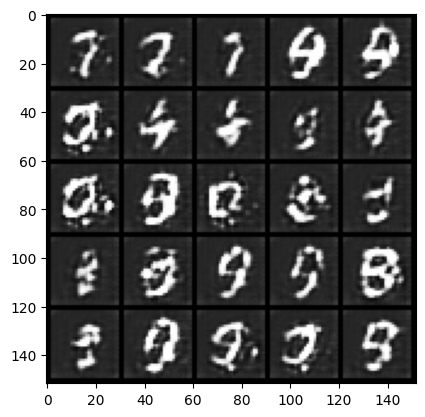

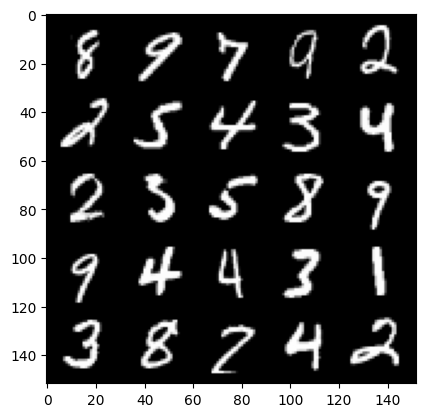

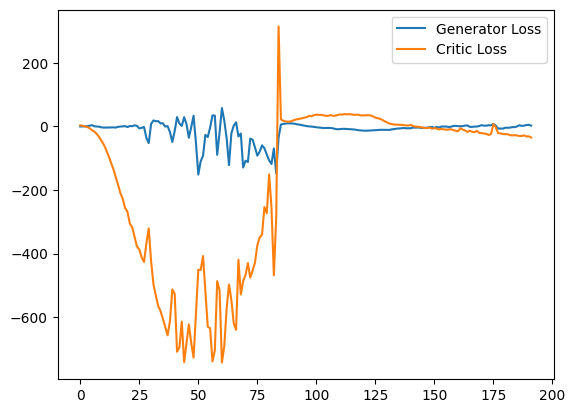

Step 3900: Generator loss: 1.4409905428439378, critic loss: -32.879334136962896


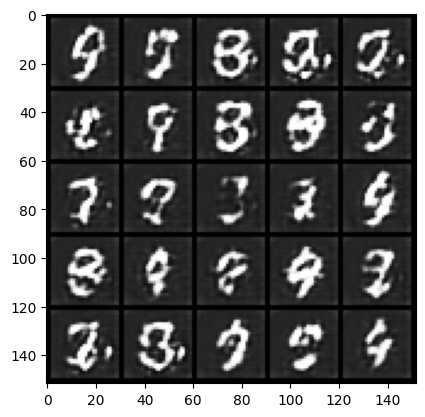

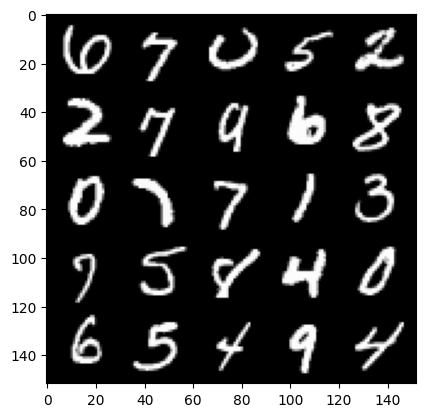

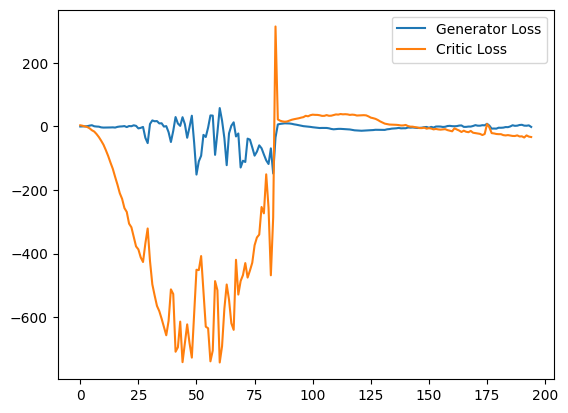

Step 3950: Generator loss: 5.379391154646873, critic loss: -34.98748401641846


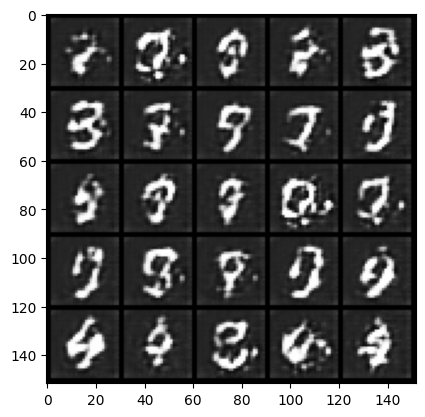

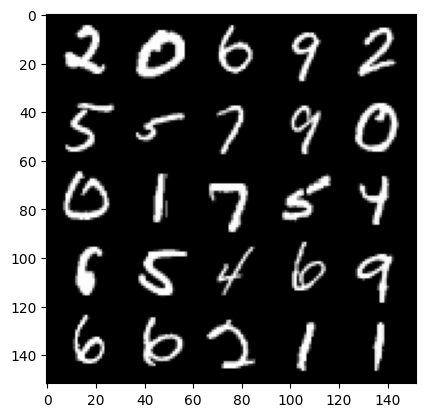

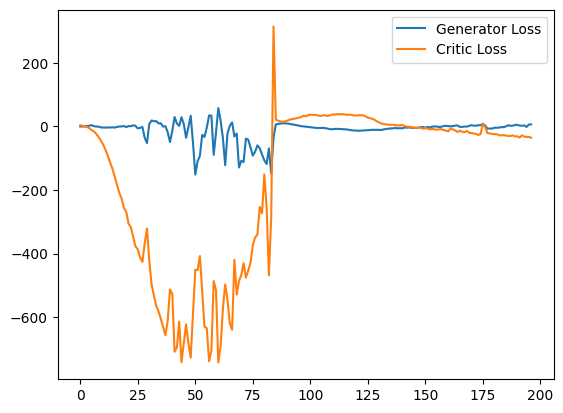

Step 4000: Generator loss: 3.140989443063736, critic loss: -34.29198186874389


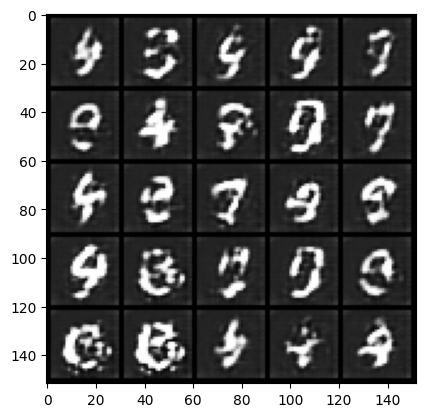

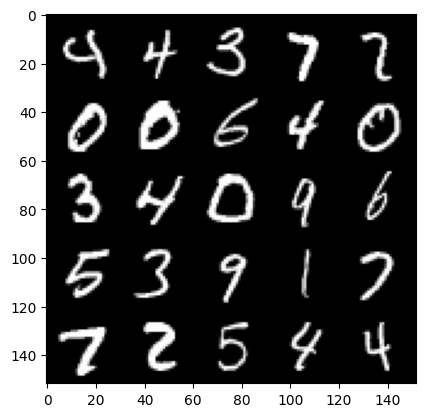

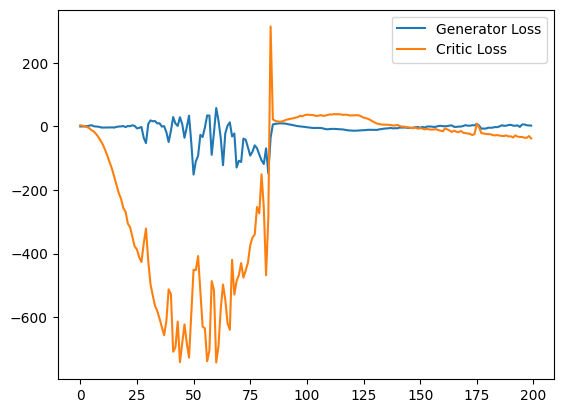

Step 4050: Generator loss: 3.2034372740983965, critic loss: -27.16036032867432


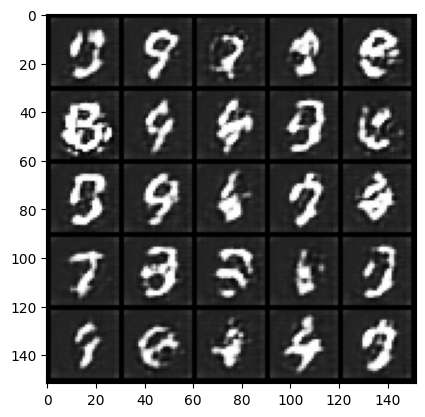

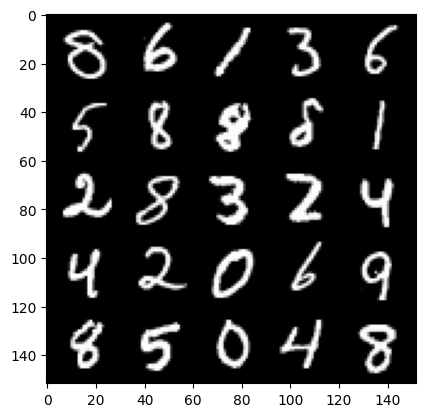

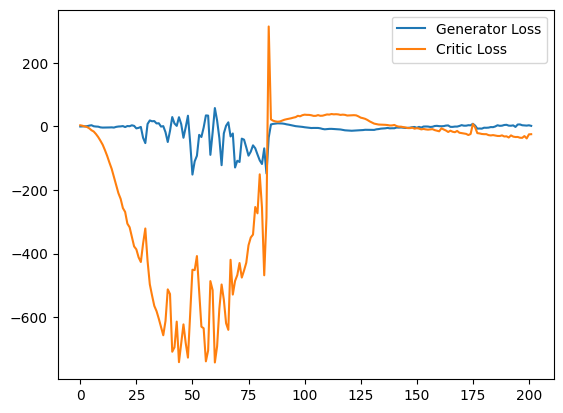

Step 4100: Generator loss: 0.9264992475509644, critic loss: -24.64078738403321


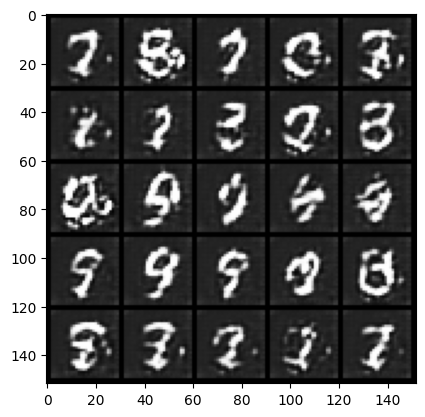

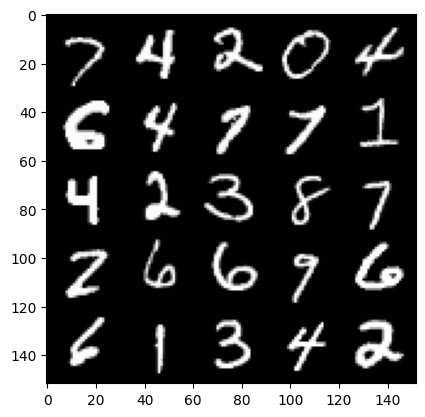

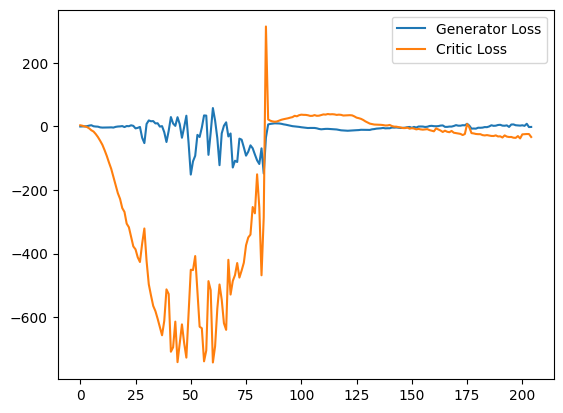

Step 4150: Generator loss: -0.14539319813251494, critic loss: -32.399090667724614


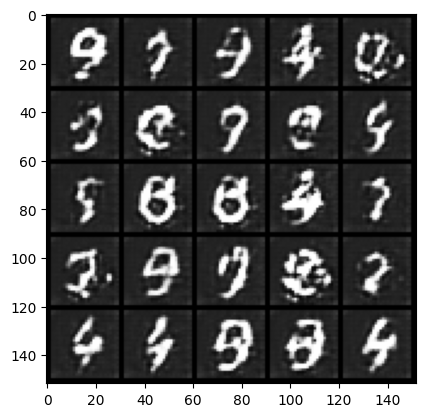

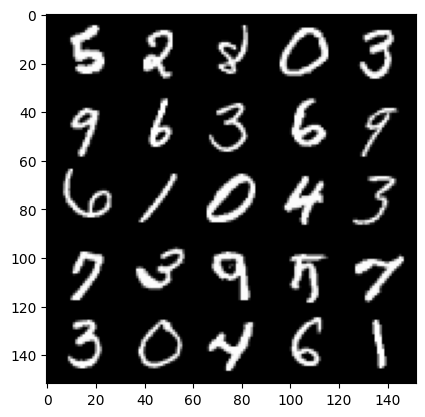

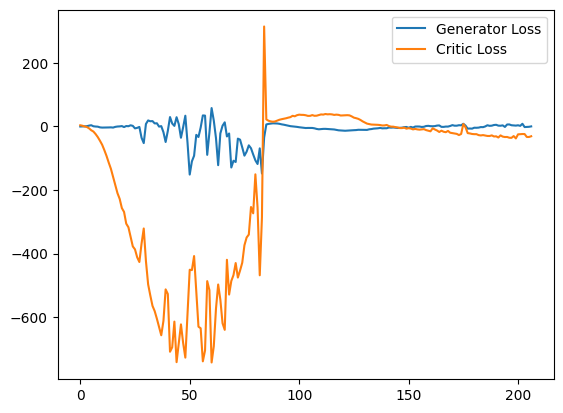

Step 4200: Generator loss: 1.5252535259723663, critic loss: -31.22888233757019


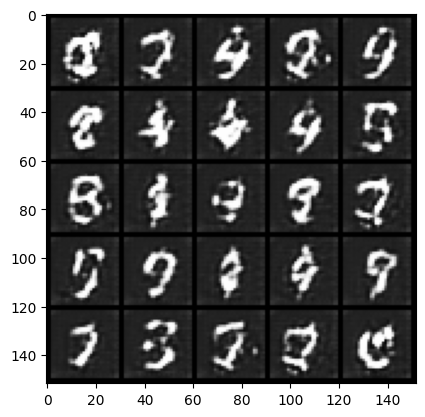

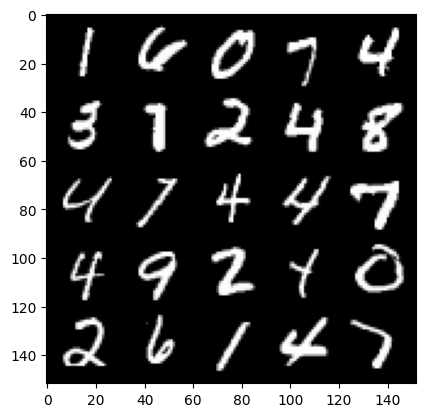

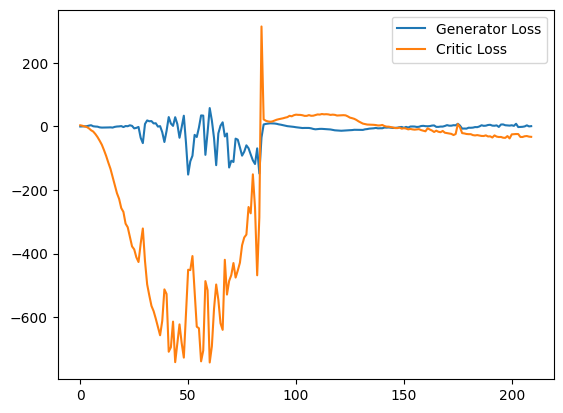

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4250: Generator loss: 0.3906847107410431, critic loss: -33.08332587432861


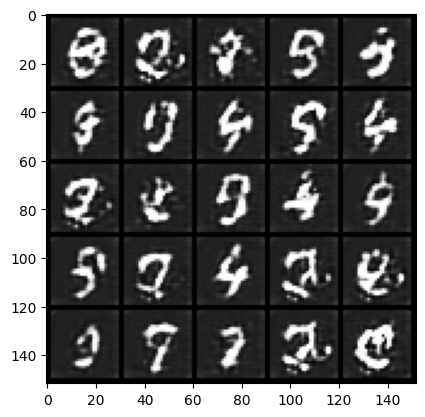

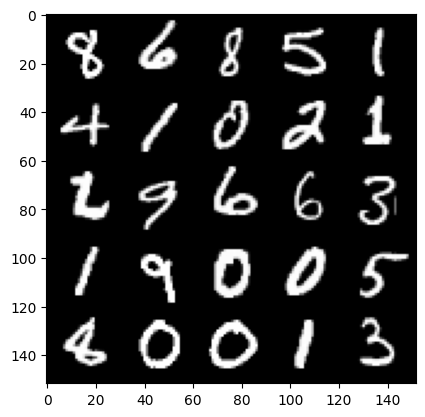

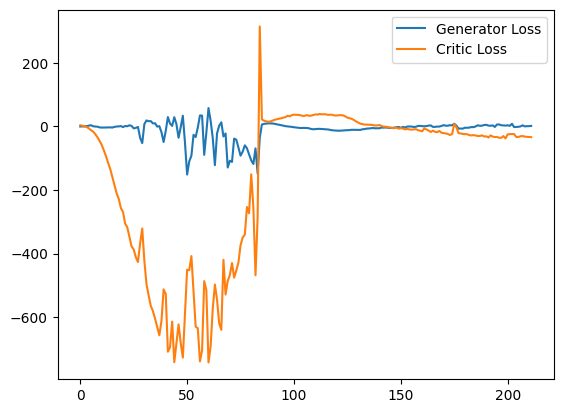

Step 4300: Generator loss: 4.2070112739503385, critic loss: -29.07534094429016


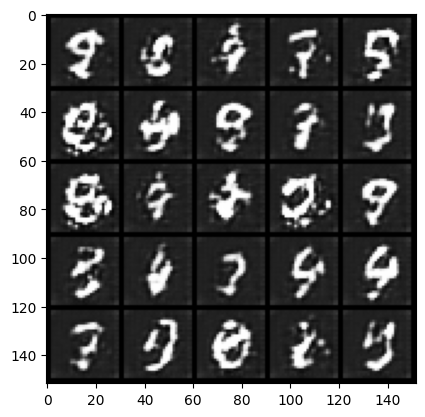

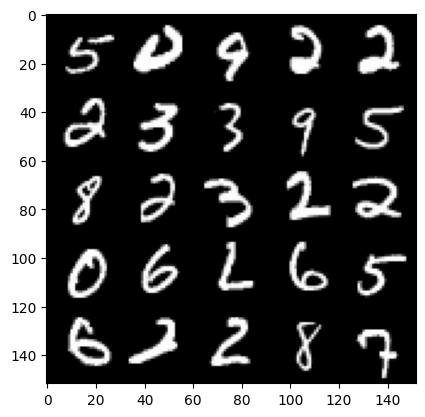

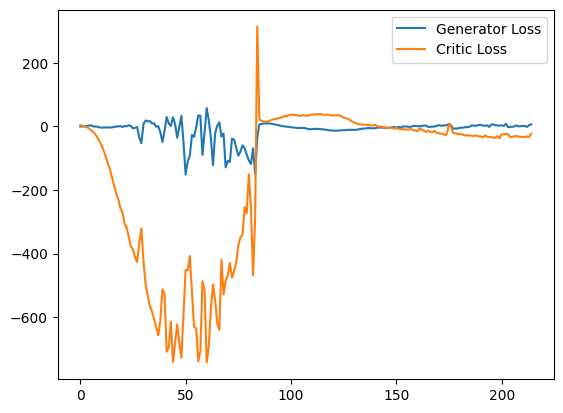

Step 4350: Generator loss: 5.240556189119816, critic loss: -32.25978876876831


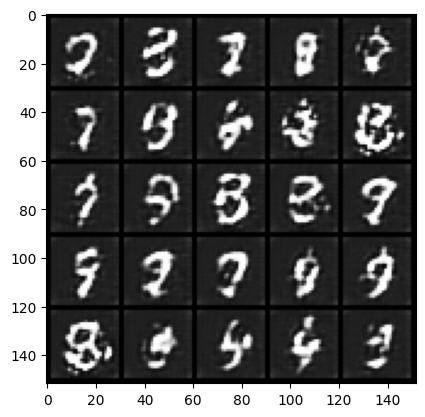

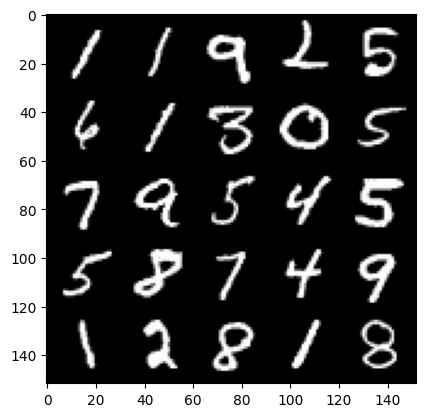

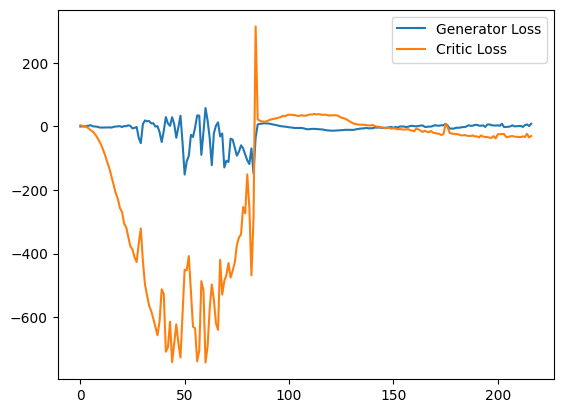

Step 4400: Generator loss: 5.55081549525261, critic loss: -26.979552949905397


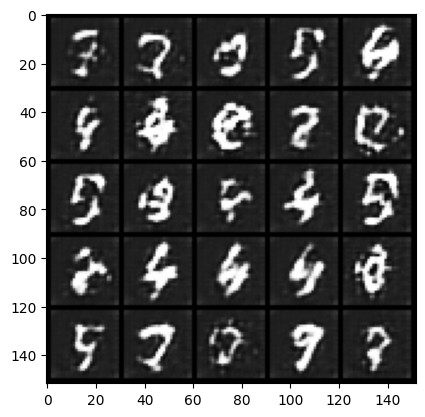

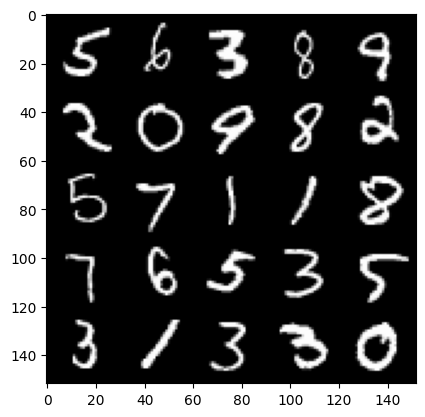

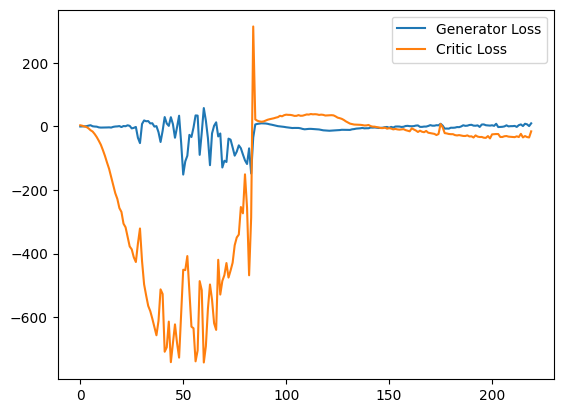

Step 4450: Generator loss: 3.6859468403458595, critic loss: -26.726031196594246


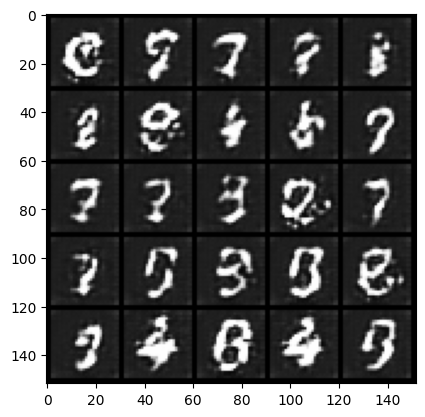

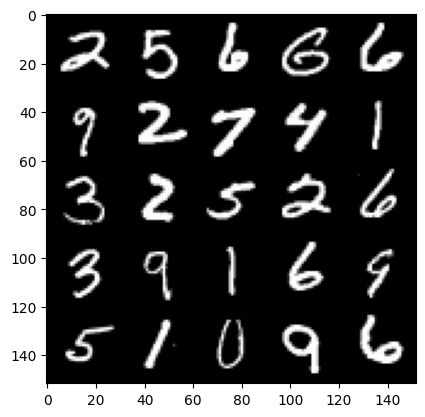

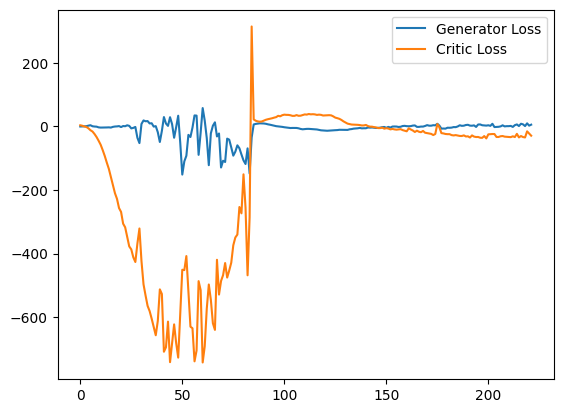

Step 4500: Generator loss: 2.4256101202964784, critic loss: -30.88773310661317


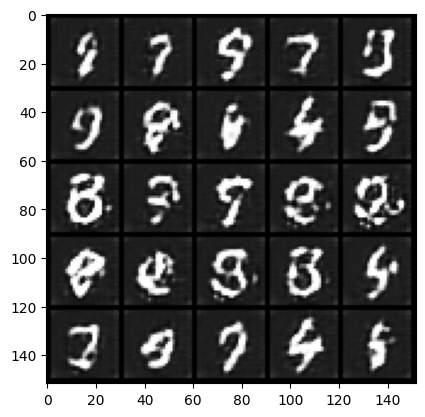

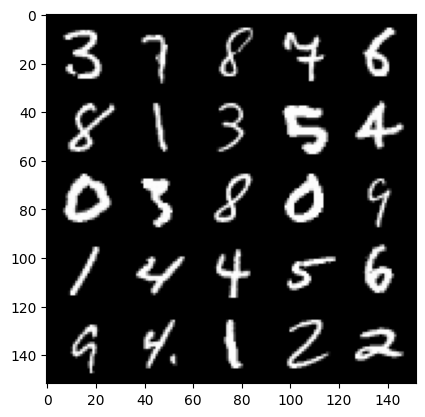

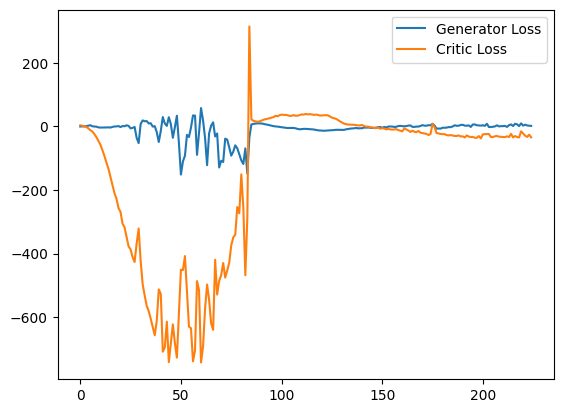

Step 4550: Generator loss: 2.7828019845485685, critic loss: -26.238951213836675


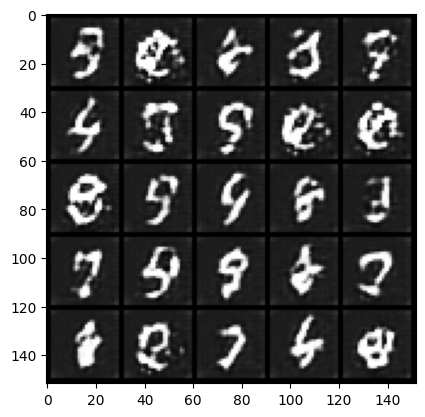

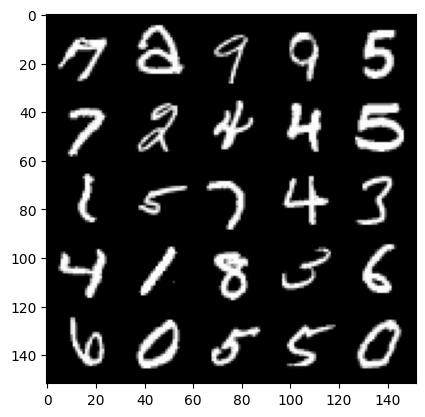

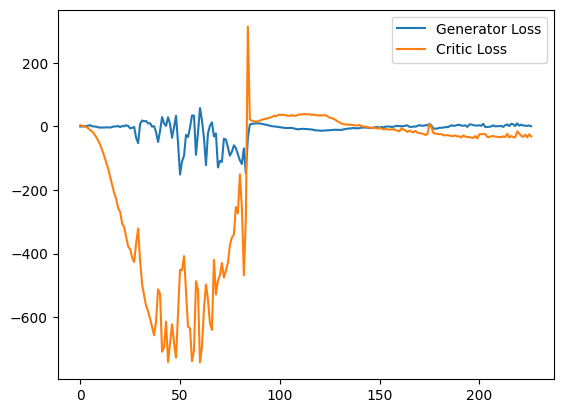

Step 4600: Generator loss: 6.190823552012444, critic loss: -21.41500631332397


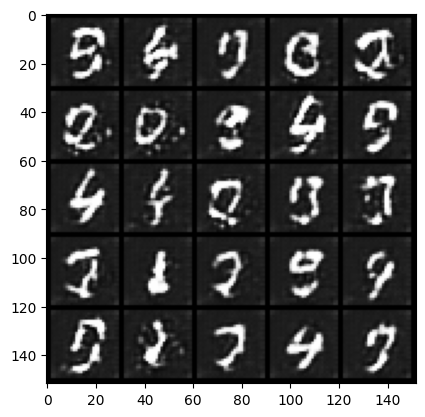

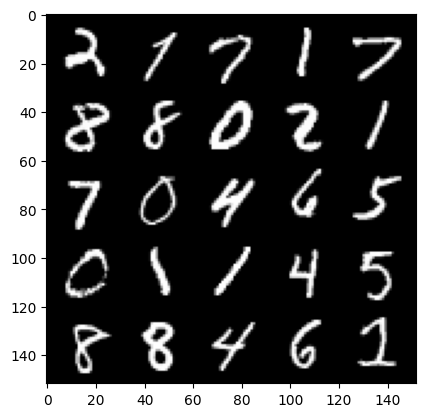

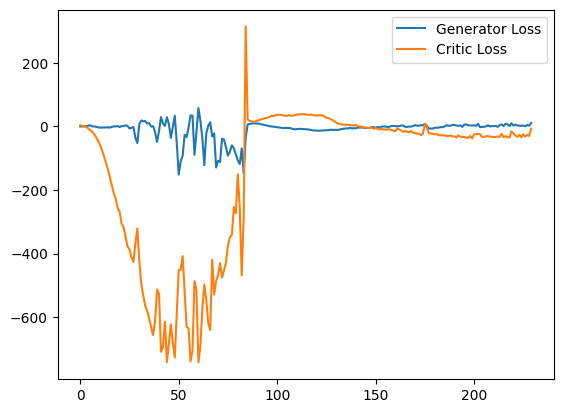

Step 4650: Generator loss: 4.376033663749695, critic loss: -27.386095106124884


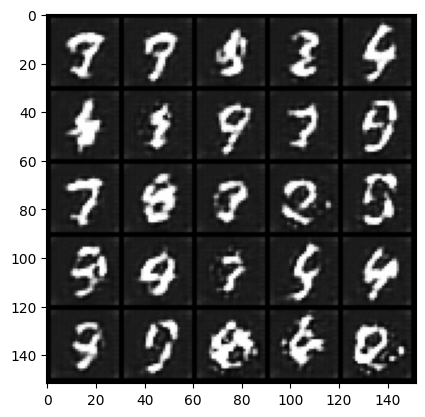

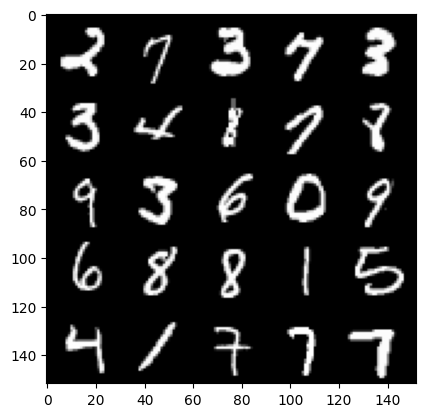

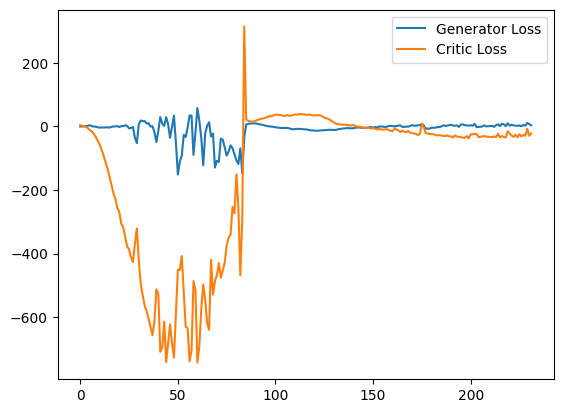

In [13]:
cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1